In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import cv2
import math

from scipy.signal import hilbert
from scipy.signal import hilbert2
import scipy.stats as stats
import scipy.signal as signal
from scipy.optimize import curve_fit
import matplotlib.mlab as mlab
import scipy.misc as misc
import scipy.special as sp
import scipy.ndimage as ndimage

import utils.distributions as dists

#jupyter notebook settings
%matplotlib inline
%config InlineBackend.print_figure_kwargs = {'dpi' : 200} #plotting pretty

## Take a look at Images

(-0.5, 825.5, 619.5, -0.5)

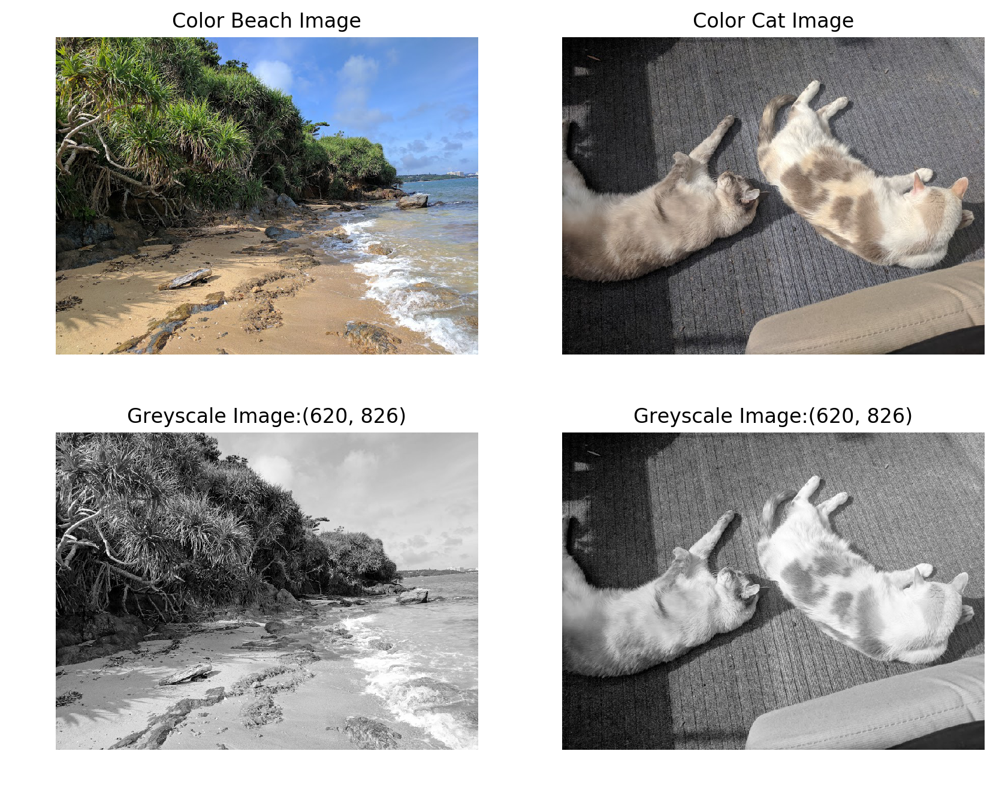

In [2]:
#Load an color image in and look at it
cbeach = cv2.imread('./images/testimages/beach.jpg')
cbeach = cv2.cvtColor(cbeach, cv2.COLOR_BGR2RGB)
bwbeach = np.mean(cbeach,axis=2)

ccats = cv2.imread('./images/testimages/cats.jpg')
ccats = cv2.cvtColor(ccats, cv2.COLOR_BGR2RGB)
bwcats = np.mean(ccats,axis=2)

plt.figure(figsize=(10,8))

plt.subplot(2,2,1)
plt.imshow(cbeach)
plt.title('Color Beach Image')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(bwbeach,cmap="Greys_r")
plt.title('Greyscale Image:{}'.format(np.shape(bwbeach)))
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(ccats)
plt.title('Color Cat Image')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(bwcats,cmap="Greys_r")
plt.title('Greyscale Image:{}'.format(np.shape(bwcats)))
plt.axis('off')


(-0.5, 825.5, 619.5, -0.5)

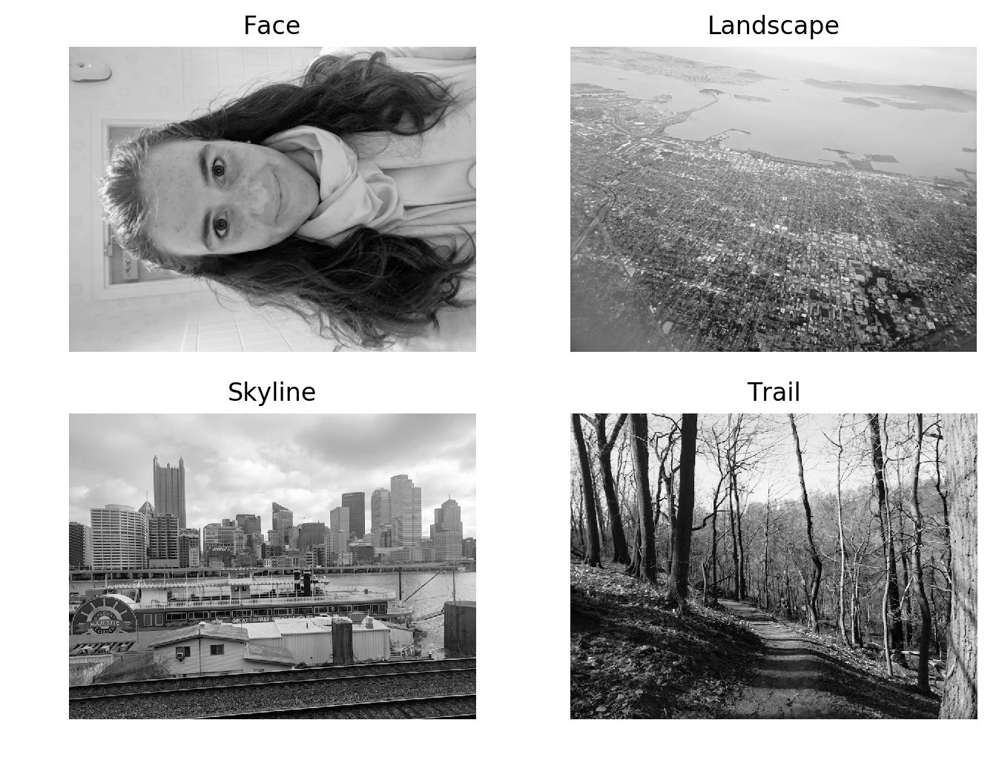

In [3]:
#face
face = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/face.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
face = face.T
#landscape
land = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/land.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
#skyline
skyline = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/skyline.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
#trail
trail = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/trail.jpg'), cv2.COLOR_BGR2RGB),axis=-1)


plt.figure(figsize=(8,6))
plt.subplot(2,2,1)
plt.imshow(face,cmap='Greys_r')
plt.title('Face')
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(land,cmap='Greys_r')
plt.title('Landscape')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(skyline,cmap='Greys_r')
plt.title('Skyline')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(trail,cmap='Greys_r')
plt.title('Trail')
plt.axis('off')

## Preprocess (Cosine Window and Subtract Mean)

In [4]:
def cosine_window(image):
    #raised cosyne window on image to avoid border artifacts
    (dim1,dim2) = np.shape(image)
    oneD = np.hanning(dim1)
    oneD = np.tile(oneD,(dim2,1)).T
    twoD = np.hanning(dim2)
    twoD = np.tile(twoD,(dim1,1))
    cosfilter = oneD*(twoD) 
    
    filtered_im = image * cosfilter
    return(filtered_im)

(-0.5, 825.5, 619.5, -0.5)

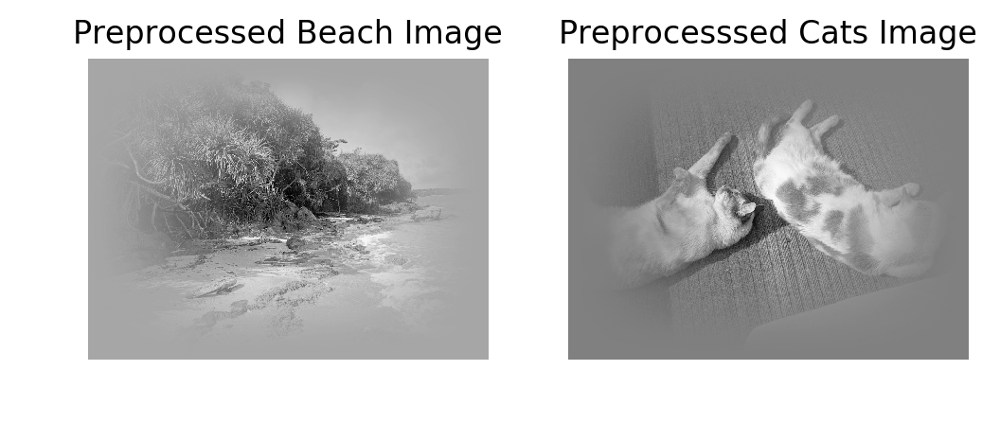

In [5]:
# #don't do this window right now. Too much of the image is thrown out.
beach = (bwbeach - np.mean(bwbeach))/np.mean(bwbeach)
cats = (bwcats - np.mean(bwcats))/np.mean(bwcats)

dimx = np.shape(cats)[0]
dimy = np.shape(cats)[1]

cwcats = cosine_window(cats)
cwbeach = cosine_window(beach)

#other images
face = (face - np.mean(face))/np.mean(face)
land = (land - np.mean(land))/np.mean(land)
skyline = (skyline - np.mean(skyline))/np.mean(skyline)
trail = (trail - np.mean(trail))/np.mean(trail)

cwface = cosine_window(face)
cwland = cosine_window(land)
cwskyline = cosine_window(skyline)
cwtrail = cosine_window(trail)

#two examples
plt.subplot(1,2,1)
plt.imshow(cwbeach,cmap="Greys_r")
plt.title('Preprocessed Beach Image')
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(cwcats,cmap="Greys_r")
plt.title('Preprocesssed Cats Image')
plt.axis('off')

## Get Amplitude & Phase

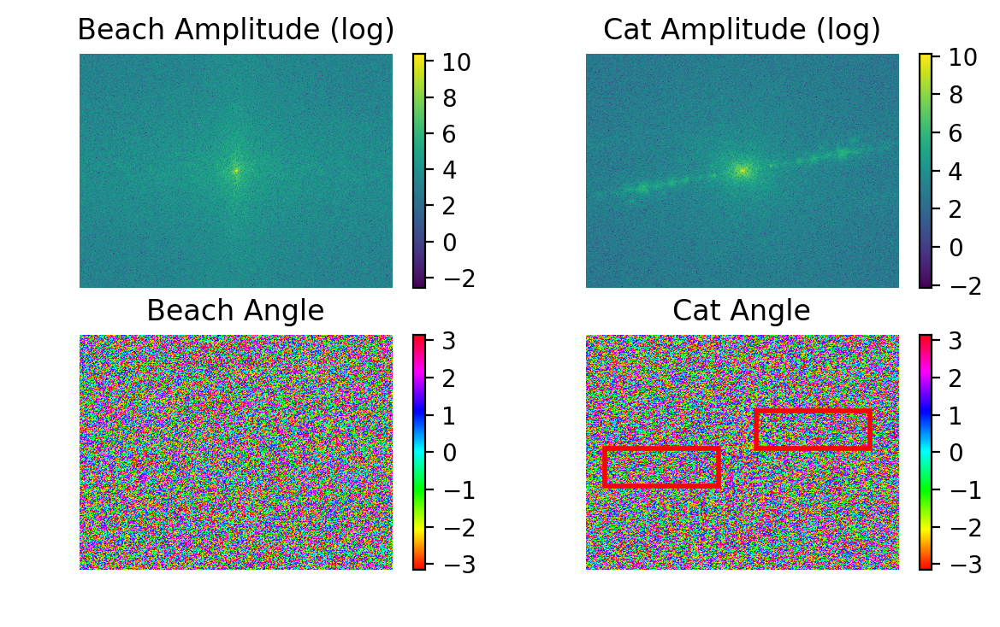

In [6]:
ft_beach = np.fft.fftshift(np.fft.fft2(cwbeach))
amp_beach = np.abs(ft_beach)
angle_beach = np.angle(ft_beach)

ft_cats = np.fft.fftshift(np.fft.fft2(cwcats))
amp_cats = np.abs(ft_cats)
angle_cats = np.angle(ft_cats)

#also get frequencies
freqs_rows = np.fft.fftshift(np.fft.fftfreq(ft_cats.shape[0],d=1/ft_cats.shape[0]))
freqs_cols = np.fft.fftshift(np.fft.fftfreq(ft_cats.shape[1],d=1/ft_cats.shape[1]))

plt.figure(figsize=(7,4))

plt.subplot(2,2,1)
plt.imshow(np.log(amp_beach))
plt.title('Beach Amplitude (log)')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(angle_beach,cmap="hsv")
plt.title('Beach Angle')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(np.log(amp_cats))
plt.title('Cat Amplitude (log)')
plt.axis('off')

plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(angle_cats,cmap="hsv")

#indexes for extracting
s1r = slice(200,300)
s1c = slice(450,750)
s2r = slice(300,400)
s2c = slice(50,350)
idx1 = [s1r, s1c]
idx2 = [s2r, s2c]

rect1 = mpl.patches.Rectangle((s1c.start,s1r.start),
                             (s1c.stop-s1c.start),
                             (s1r.stop-s1r.start),
                             linewidth=2,edgecolor='r',facecolor='none')

rect2 = mpl.patches.Rectangle((s2c.start,s2r.start),
                             (s2c.stop-s2c.start),
                             (s2r.stop-s2r.start),
                             linewidth=2,edgecolor='r',facecolor='none')
ax = plt.gca()
ax.add_patch(rect1)
ax.add_patch(rect2)



plt.title('Cat Angle')
plt.axis('off')
plt.colorbar()



Didn't get to threshold! stopped at 10 iterations.


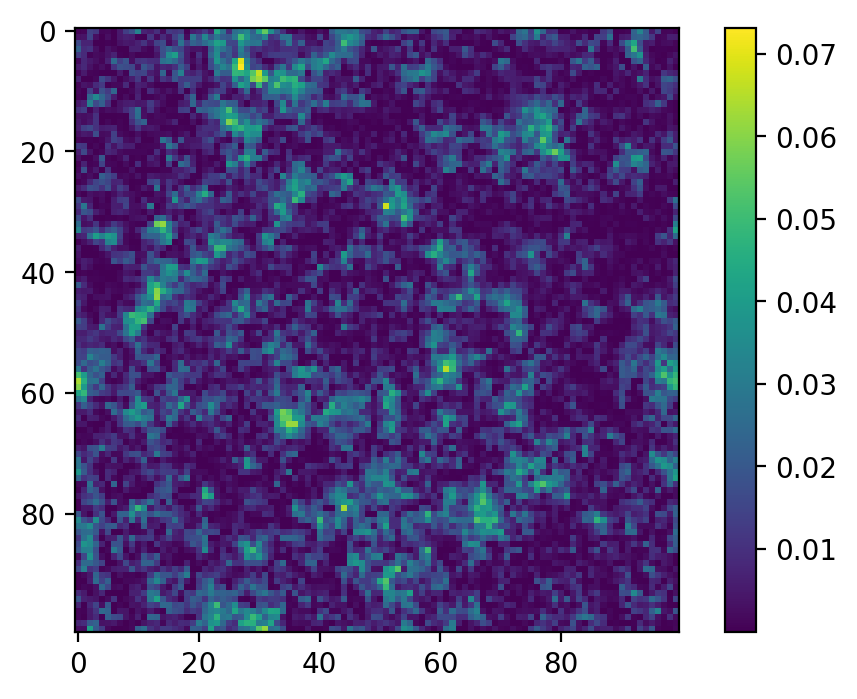

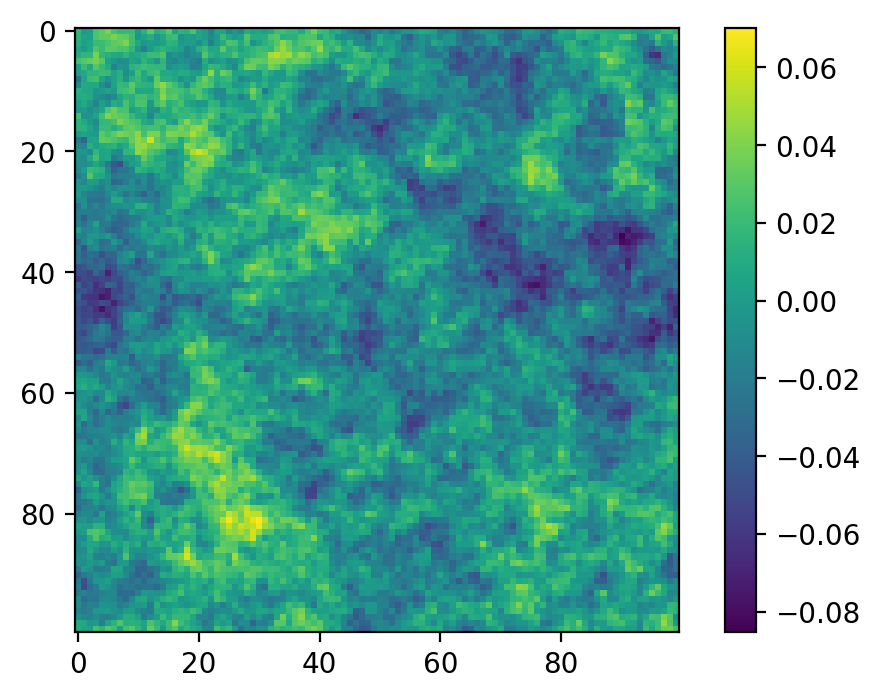

In [152]:
%matplotlib inline
import utils.pc_utils as pcu
from utils.pc_utils import fft_recon_im

img, im_seed, amp, phi, evol = pcu.gen_pc((100,100),max_iters=10, onef_k=100)

myft = np.fft.fftshift(np.fft.fft2(img))
myamp = np.abs(myft)
myphi = np.angle(myft)

# plt.imshow(myamp - amp)
# plt.colorbar()
# plt.show()

# plt.imshow(myphi - phi)
# plt.colorbar()
# plt.show()

plt.imshow(np.abs(np.fft.ifft2(np.fft.ifftshift(amp*np.exp(1j*phi))))-np.abs(np.fft.ifft2(np.fft.ifftshift(myamp*np.exp(1j*myphi)))))
plt.colorbar()
plt.show()
plt.imshow(img)
plt.colorbar()

## A few more images with different statistics to check invariances

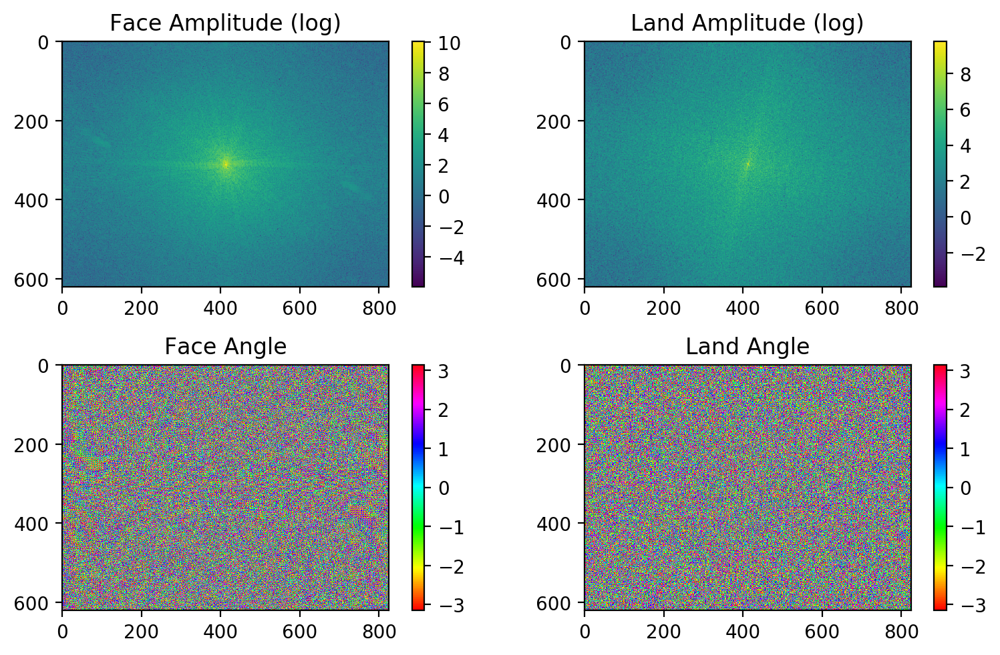

In [7]:
ft_face = np.fft.fftshift(np.fft.fft2(cwface))
amp_face = np.abs(ft_face)
angle_face = np.angle(ft_face)

ft_land = np.fft.fftshift(np.fft.fft2(cwland))
amp_land = np.abs(ft_land)
angle_land = np.angle(ft_land)

plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(np.log(amp_face))
plt.title('Face Amplitude (log)')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(angle_face,cmap="hsv")
plt.title('Face Angle')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(np.log(amp_land))
plt.title('Land Amplitude (log)')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(angle_land,cmap="hsv")
plt.title('Land Angle')
plt.colorbar()

plt.tight_layout()

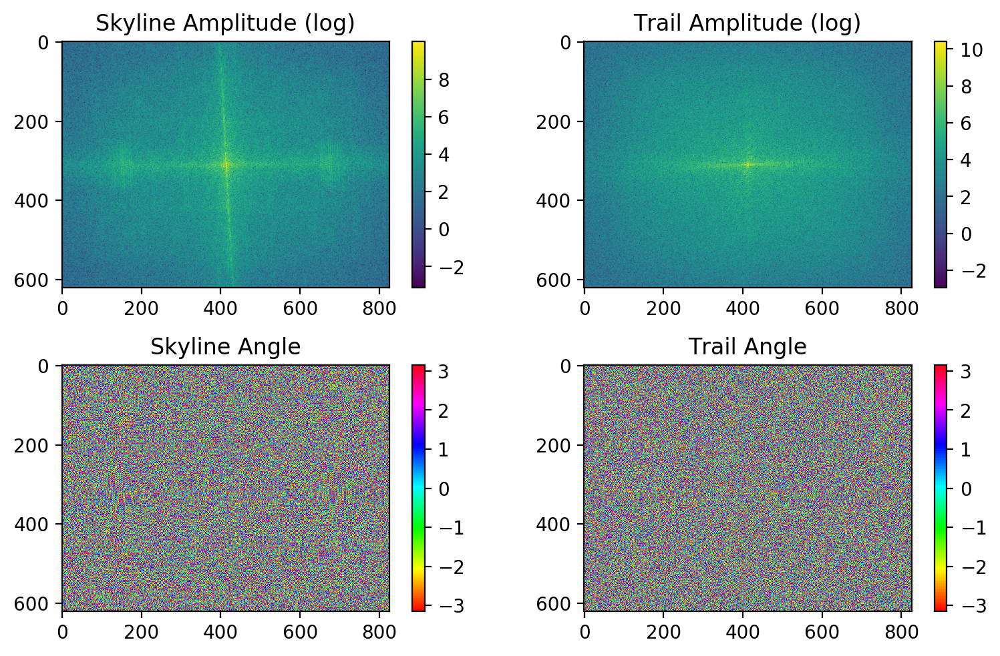

In [8]:
ft_skyline = np.fft.fftshift(np.fft.fft2(cwskyline))
amp_skyline = np.abs(ft_skyline)
angle_skyline = np.angle(ft_skyline)

ft_trail = np.fft.fftshift(np.fft.fft2(cwtrail))
amp_trail = np.abs(ft_trail)
angle_trail = np.angle(ft_trail)

plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(np.log(amp_skyline))
plt.title('Skyline Amplitude (log)')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(angle_skyline,cmap="hsv")
plt.title('Skyline Angle')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(np.log(amp_trail))
plt.title('Trail Amplitude (log)')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(angle_trail,cmap="hsv")
plt.title('Trail Angle')
plt.colorbar()

plt.tight_layout()

## Look at the angle photos, enlarged

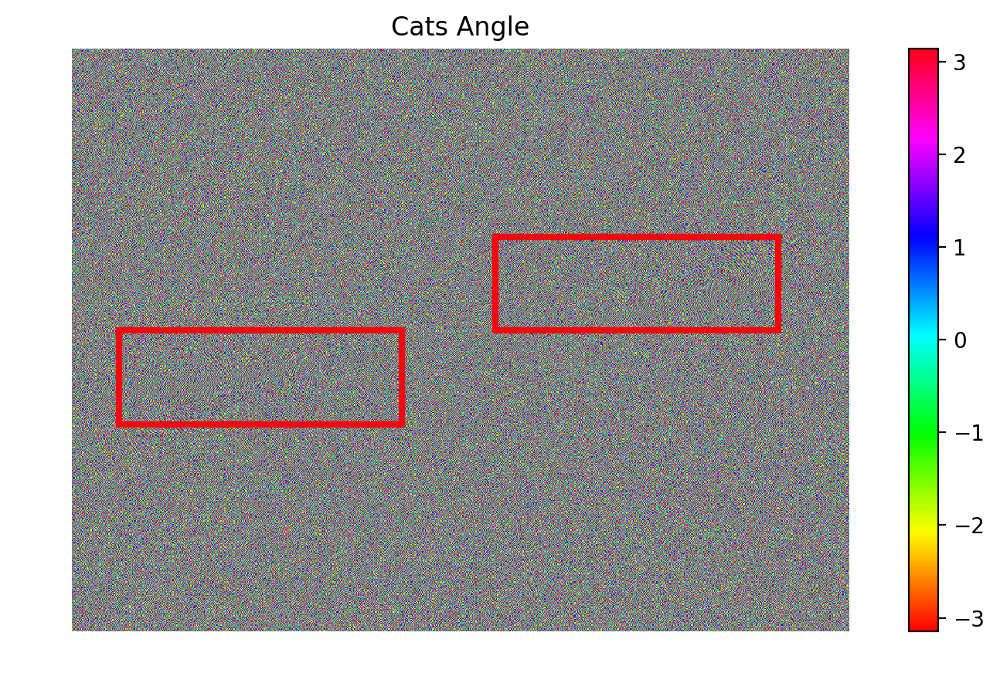

In [9]:
plt.figure(figsize=(10,5))
plt.imshow(angle_cats,cmap="hsv")

#indexes for extracting
s1r = slice(200,300)
s1c = slice(450,750)
s2r = slice(300,400)
s2c = slice(50,350)
idx1 = [s1r, s1c]
idx2 = [s2r, s2c]

rect1 = mpl.patches.Rectangle((s1c.start,s1r.start),
                             (s1c.stop-s1c.start),
                             (s1r.stop-s1r.start),
                             linewidth=3,edgecolor='r',facecolor='none')

rect2 = mpl.patches.Rectangle((s2c.start,s2r.start),
                             (s2c.stop-s2c.start),
                             (s2r.stop-s2r.start),
                             linewidth=3,edgecolor='r',facecolor='none')
ax = plt.gca()
ax.add_patch(rect1)
ax.add_patch(rect2)

plt.title('Cats Angle')
plt.axis('off')
plt.colorbar()

## Look at Subset of Phase with Interesting Structure

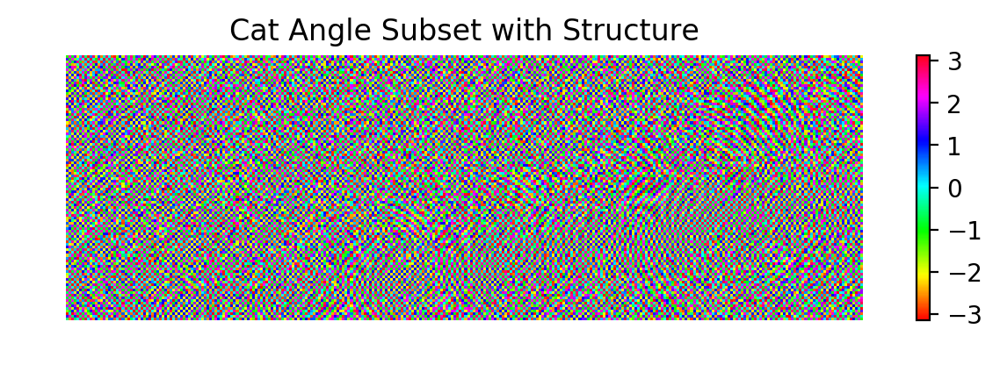

In [10]:
plt.figure(figsize=(8,2))
#plt.subplot(2,1,1)
plt.imshow(angle_cats[idx1],cmap="hsv")
plt.title('Cat Angle Subset with Structure')
plt.axis('off')
plt.colorbar()

# plt.subplot(2,1,2)
# plt.imshow(angle_cats[idx2],cmap="hsv")
# plt.title('Cat Angle Subset with Structure')
# plt.axis('off')
# plt.colorbar()


I suspect this is the carpet in the photo, a strong repetative pattern

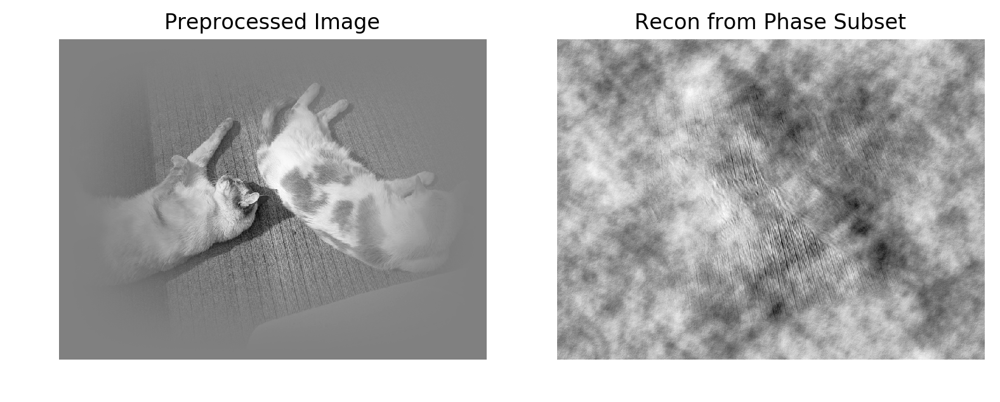

In [11]:
rand_phase_cat_subset = np.random.rand(*np.shape(angle_cats))*2*np.pi+np.pi
rand_phase_cat_subset[idx1] = angle_cats[idx1]
rand_phase_cat_subset[idx2] = angle_cats[idx2]
rand_phase_cat_subset_recon = np.fft.ifft2(np.fft.ifftshift(amp_cats* np.exp(1j*rand_phase_cat_subset)))

plt.figure(figsize=(8,4))

plt.subplot(1,2,1)
plt.imshow(cwcats,cmap='Greys_r')
plt.axis('off')
plt.title('Preprocessed Image')

plt.subplot(1,2,2)
plt.imshow(np.real(rand_phase_cat_subset_recon),cmap='Greys_r')
plt.axis('off')
plt.title('Recon from Phase Subset')
plt.tight_layout()

In [12]:
def calc_entropy(im, rescale=True):
    
    im = im.flatten()

    #bin 
    counts,boundaries = np.histogram(im)
    centers = (boundaries[1:] + boundaries[:-1])/2

    vals_prob = counts.astype(np.float) / np.sum(counts)

    #calc entropy contribution for each instance
    #some values are zero because they have probability zero. Make these zero
    vals_entropy_contrib = -1* vals_prob * np.nan_to_num(np.log(vals_prob)/np.log(2))

    #calc entropy total
    entropy = np.sum(vals_entropy_contrib)

    return(entropy)

In [13]:
random_phase = np.random.rand(*np.shape(cats))*2*np.pi - np.pi
print('Cat phase entropy is: {:.5f}'.format(calc_entropy(angle_cats)))
print('Beach phase entropy is: {:.5f}'.format(calc_entropy(angle_beach)))
print('Uniform Random phase entropy is: {:.5f}'.format(calc_entropy(random_phase)))
print('Cat Image entropy is: {:.5f}'.format(calc_entropy(cats)))
print('Beach Image entropy is: {:.5f}'.format(calc_entropy(beach)))

Cat phase entropy is: 3.32191
Beach phase entropy is: 3.32192
Uniform Random phase entropy is: 3.32191
Cat Image entropy is: 3.08638
Beach Image entropy is: 3.06029


In [14]:
fullim_window = False
if(fullim_window):
    winsize = (30,30)
    edgemode = 'reflect'

    entcat = ndimage.generic_filter(angle_cats, calc_entropy, size=winsize, mode=edgemode)
    #remove edgeartifacts
    entcat = entcat[winsize[0]//2:-winsize[0]//2,winsize[1]//2:-winsize[1]//2]
    plt.figure(figsize=(11,6))

    plt.subplot(2,1,1)
    plt.imshow(entcat)
    plt.title('Entropy of Cat Angle')
    plt.axis('off')
    plt.colorbar()

    entrand = ndimage.generic_filter(np.random.rand(*np.shape(angle_cats))*2*np.pi - np.pi, calc_entropy, size=winsize, mode=edgemode)
    entrand = entrand[winsize[0]//2:-winsize[0]//2,winsize[1]//2:-winsize[1]//2]
    plt.subplot(2,1,2)
    plt.title('Entropy of Uniform Random')
    plt.imshow(entrand)
    plt.axis('off')
    plt.colorbar()

In [15]:
if(fullim_window):
    pmean = np.mean(entcat)
    plt.hist(entcat.flatten(),bins=50, alpha = 0.5, log='y',label='Cat Phase $\mu$ = {0:0.3f}'.format(pmean));

    rmean = np.mean(entrand)
    plt.hist(entrand.flatten(),bins=50, alpha = 0.5, log='y',label='Unif. Rand $\mu$ = {0:0.3f}'.format(rmean));

    plt.xlabel('Entropy')
    plt.ylabel('Log Occurances')
    plt.title('Windowed Entropy Distribution')
    plt.legend()

/home/vasha/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]


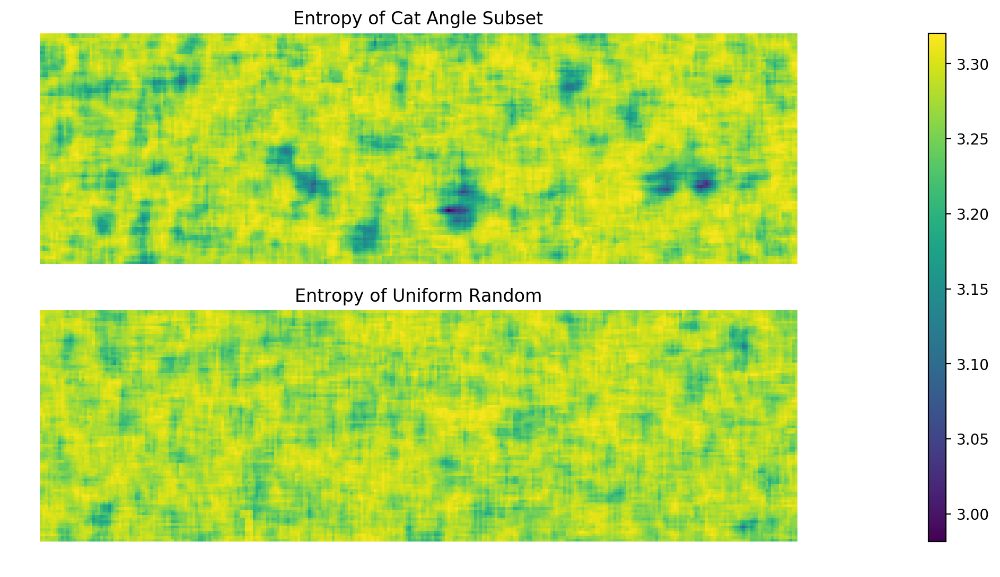

In [51]:
winsize = (12,12)
edgemode = 'reflect'

entcatsub = ndimage.generic_filter(angle_cats[idx1], calc_entropy, size=winsize, mode=edgemode)
#remove edgeartifacts
entcatsub = entcatsub[winsize[0]//2:-winsize[0]//2,winsize[1]//2:-winsize[1]//2]

rando = np.random.rand((s1r.stop-s1r.start),(s1c.stop-s1c.start))*2*np.pi - np.pi
entrandsub = ndimage.generic_filter(rando, calc_entropy, size=winsize, mode=edgemode)
entrandsub = entrandsub[winsize[0]//2:-winsize[0]//2,winsize[1]//2:-winsize[1]//2]


plt.figure(figsize=(11,6))

vmin=np.min(np.vstack((entcatsub, entrandsub)))
vmax=np.max(np.vstack((entcatsub, entrandsub)))

plt.subplot(2,1,1)
plt.imshow(entcatsub, vmin=vmin, vmax=vmax)
plt.title('Entropy of Cat Angle Subset')
plt.axis('off')
#plt.colorbar()


plt.subplot(2,1,2)
plt.title('Entropy of Uniform Random')
plt.imshow(entrandsub, vmin=vmin, vmax=vmax)
plt.axis('off')
#plt.colorbar()

plt.subplots_adjust(bottom=0.1, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.1, 0.015, 0.8])
plt.colorbar(cax=cax)
plt.show()

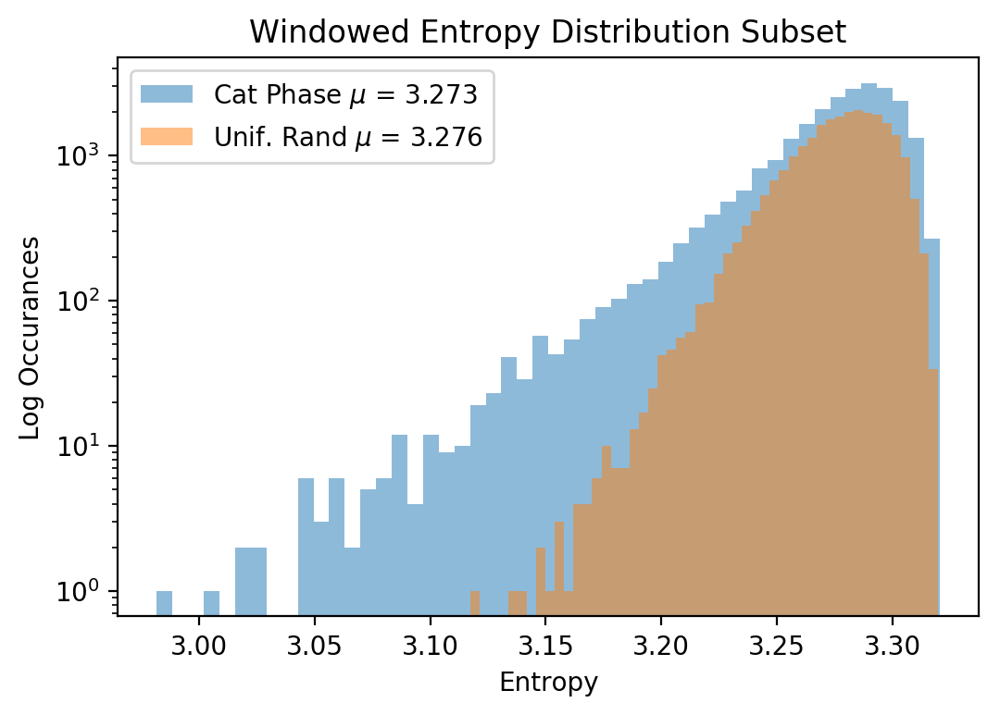

In [17]:
pmean = np.mean(entcatsub)
plt.hist(entcatsub.flatten(),bins=50, alpha = 0.5, log='y',label='Cat Phase $\mu$ = {0:0.3f}'.format(pmean));

rmean = np.mean(entrandsub)
plt.hist(entrandsub.flatten(),bins=50, alpha = 0.5, log='y',label='Unif. Rand $\mu$ = {0:0.3f}'.format(rmean));

plt.xlabel('Entropy')
plt.ylabel('Log Occurances')
plt.title('Windowed Entropy Distribution Subset')
plt.legend()

Interestingly we don't see much entropy differences between the areas that appear strcutured and unstructed. This doesn't seem to vary much with window size either. try an image that is completally natural, no carpet or man-made repetative patterns

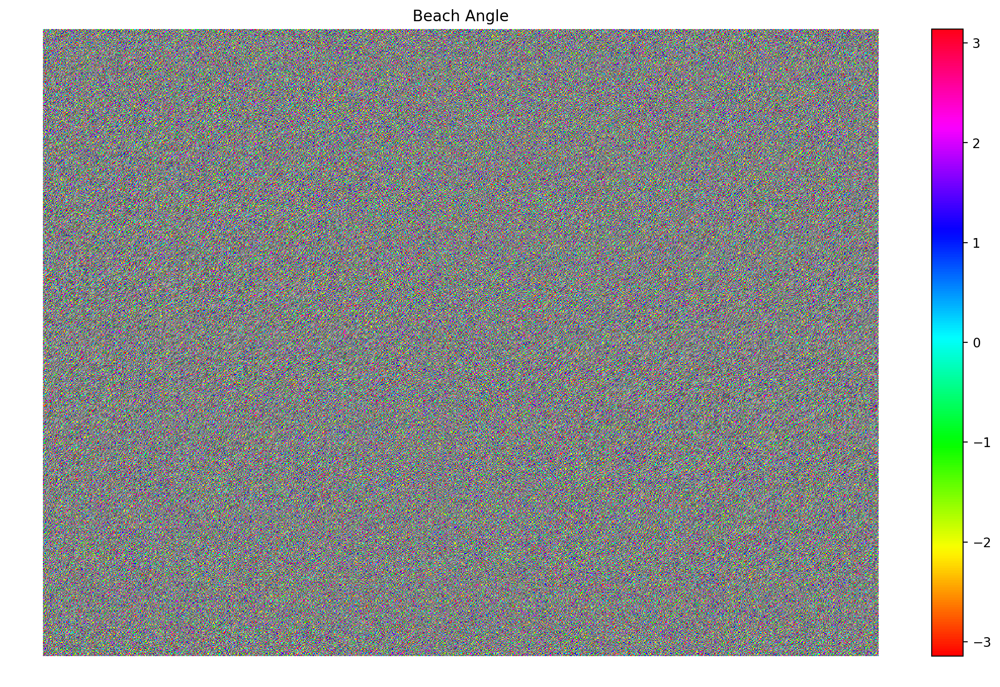

In [18]:
plt.figure(figsize=(15,9))
plt.imshow(angle_beach,cmap="hsv")
plt.title('Beach Angle')
plt.axis('off')
plt.colorbar()

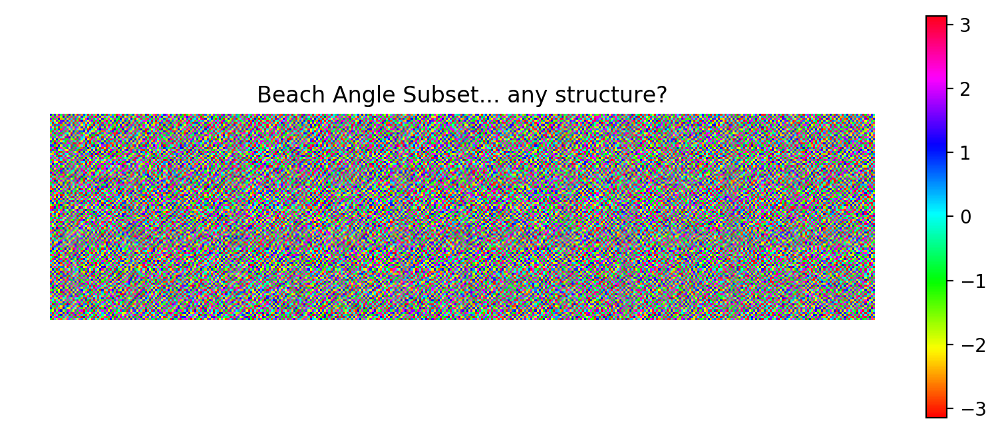

In [19]:
plt.figure(figsize=(10,4))
plt.imshow(angle_beach[100:200,100:500],cmap="hsv")
plt.title('Beach Angle Subset... any structure?')
plt.axis('off')
plt.colorbar()

/home/vasha/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]


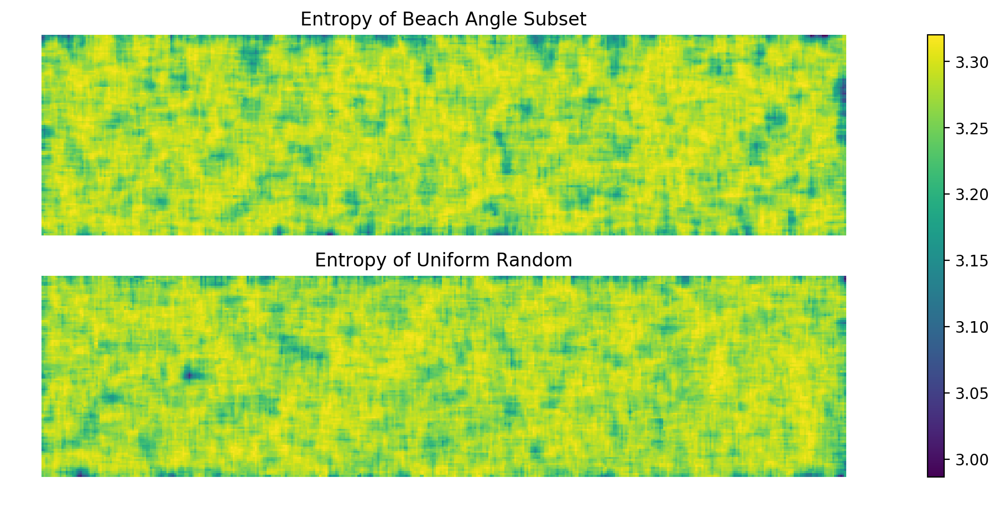

In [53]:
beachsub = ndimage.generic_filter(angle_beach[100:200,100:500], calc_entropy, size=winsize)
randsub = ndimage.generic_filter(np.random.rand(100,400)*2*np.pi - np.pi, calc_entropy, size=winsize)

vmin=np.min(np.vstack((beachsub, randsub)))
vmax=np.max(np.vstack((beachsub, randsub)))

plt.figure(figsize=(10,5))

plt.subplot(2,1,1)
plt.imshow(beachsub, vmin=vmin, vmax=vmax)
plt.title('Entropy of Beach Angle Subset')
#plt.colorbar()
plt.axis('off')

plt.subplot(2,1,2)
plt.title('Entropy of Uniform Random')
plt.imshow(randsub, vmin=vmin, vmax=vmax)
#plt.colorbar()
plt.axis('off')

plt.subplots_adjust(bottom=0.1, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.1, 0.015, 0.8])
plt.colorbar(cax=cax)
plt.show()

plt.tight_layout()

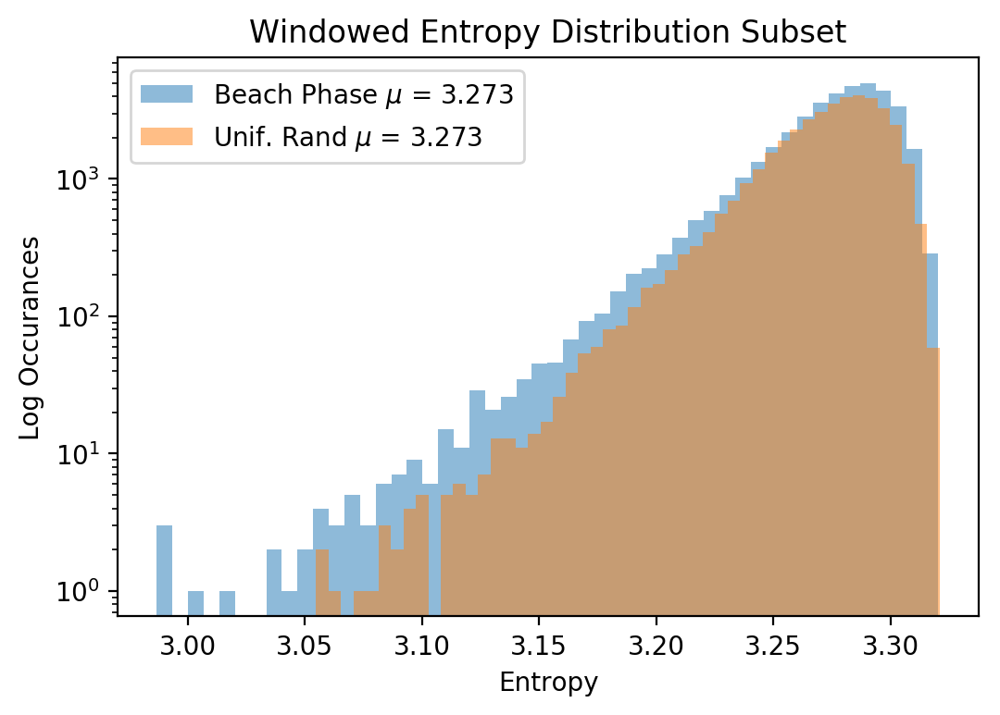

In [21]:
pmean = np.mean(beachsub)
plt.hist(beachsub.flatten(),bins=50, alpha = 0.5, log='y',label='Beach Phase $\mu$ = {0:0.3f}'.format(pmean));

rmean = np.mean(randsub)
plt.hist(randsub.flatten(),bins=50, alpha = 0.5, log='y',label='Unif. Rand $\mu$ = {0:0.3f}'.format(rmean));

plt.xlabel('Entropy')
plt.ylabel('Log Occurances')
plt.title('Windowed Entropy Distribution Subset')
plt.legend()

These two appear identical in terms of their entropy over small windows.

In addition, over the entire image, the phase spectrum for natural images appears as random as uniform random up to 0.0001 ... It is a reliably higher entropy value than the entropy of the images themselves. In the case of the carpet in the cat image for example, we know it is not truly random and does contain structure, but this is not measurable using entropy...

The Fourier transform is a linear transform on our image, and we know that the entropy is NOT invariant over any linear transform: 

If $f$ is an invertible transform of a real variable x, y = f(x) then:
$$ H(y) = H(x) + E[log|detJf(x)|] $$
where $Jf(\xi)$ is a Jacobian of $f$ (a matrix of partial derivates at $\xi$.

This is quite 'global' coherence such that it is hard to see at the local scale. With a <10x10 patch it is nearly impossible to see. 

## Look at Low Frequency Phases (look intersting when we forget cosine window)

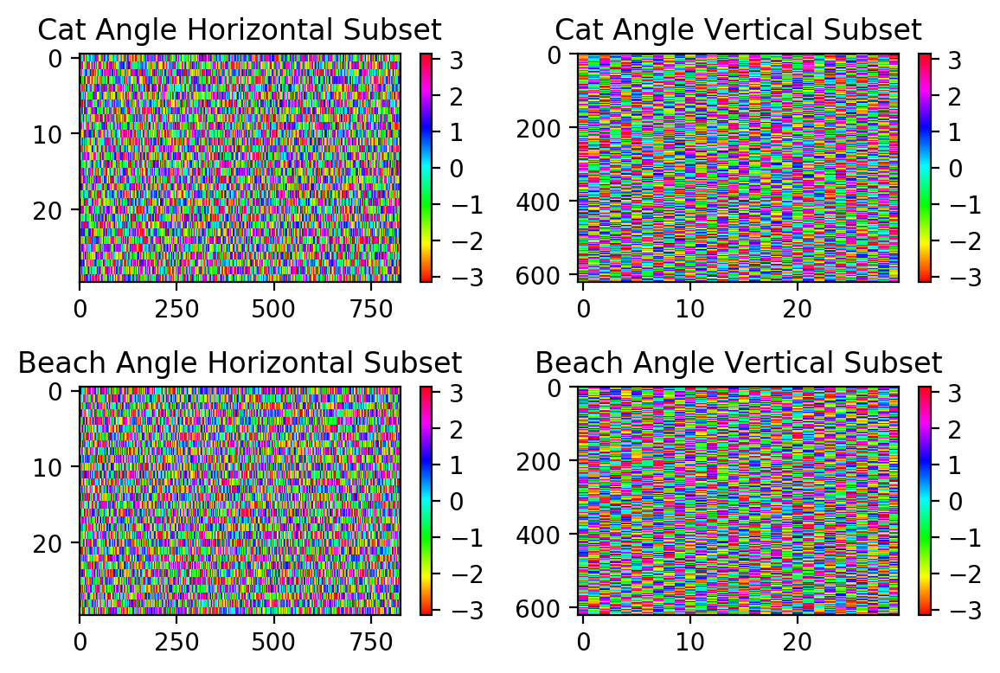

In [22]:
nlowphases = 30
neachside = int(nlowphases/2)

xhalf = np.int(np.shape(angle_cats)[0]/2)
yhalf = np.int(np.shape(angle_cats)[1]/2)

plt.subplot(2,2,1)
plt.imshow(angle_cats[xhalf-neachside:xhalf+neachside,:],cmap="hsv", aspect='auto')
plt.title('Cat Angle Horizontal Subset')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(angle_cats[:,yhalf-neachside:yhalf+neachside],cmap="hsv", aspect='auto')
plt.title('Cat Angle Vertical Subset')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(angle_beach[xhalf-neachside:xhalf+neachside,:],cmap="hsv", aspect='auto')
plt.title('Beach Angle Horizontal Subset')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(angle_beach[:,yhalf-neachside:yhalf+neachside],cmap="hsv", aspect='auto')
plt.title('Beach Angle Vertical Subset')
plt.colorbar()

plt.tight_layout()

## Phase Distributions

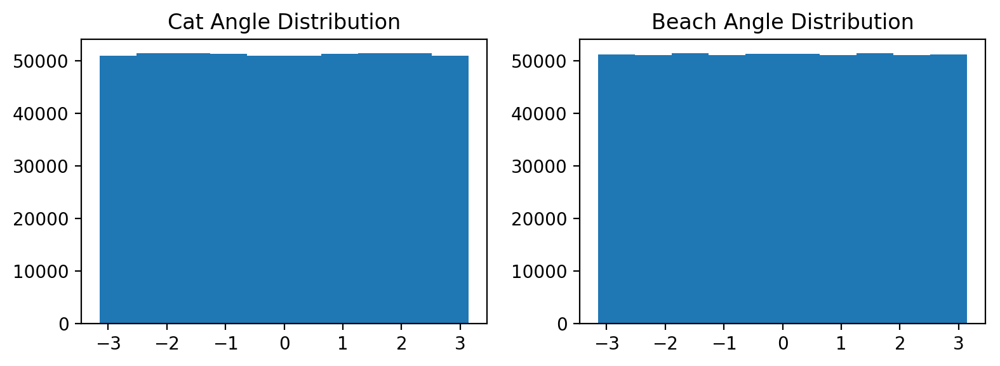

In [23]:
plt.figure(figsize=(8,3))

plt.subplot(1,2,1)
plt.hist(angle_cats.flatten())
plt.title('Cat Angle Distribution')

plt.subplot(1,2,2)
plt.hist(angle_beach.flatten())
plt.title('Beach Angle Distribution')

plt.tight_layout()

Almost a completally even distribution. What about with regards to frequency?

What if we used entropy to quantify this difference in coherence?

What if we used entropy to quantify this difference in coherence?

Text(0.5,1,'Entropy of Phase Angle')

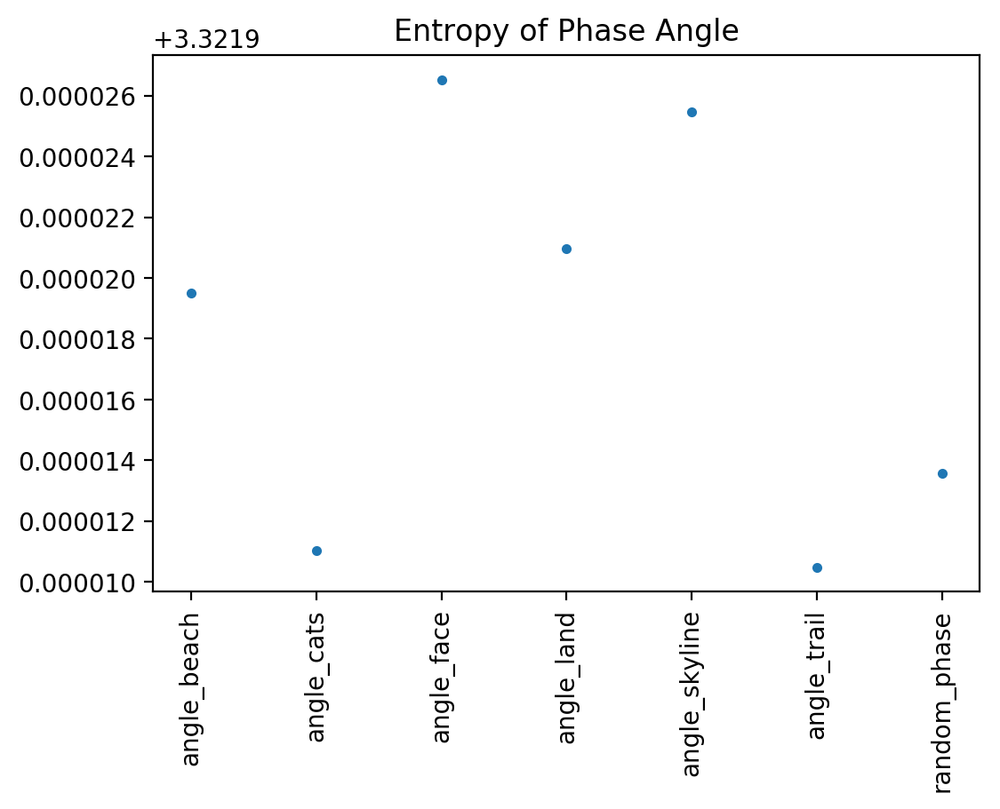

In [24]:
#code to print namestring
def namestr(obj, namespace):
    return [name for name in namespace if namespace[name] is obj]

#random values
random_phase = np.random.rand(ft_cats.shape[0],ft_cats.shape[1])*2*np.pi - np.pi
images =  [angle_cats, angle_beach, angle_face, angle_land, angle_skyline, angle_trail, random_phase]
labels = [namestr(item, globals())[0] for item in images]
entropies = [calc_entropy(item) for item in images]

plt.plot(labels, entropies, '.')
plt.xticks(rotation=90)
plt.title('Entropy of Phase Angle')

## Phase Entropy by Radius

In [25]:
def radial_Analysis(signal2d, func, center=None):
    """
    Calculate function of a signal for all values at a given radius.

    signal2d - 2d signal to be analyzed (not necessarily an signal_2ds)
    func - function to be applied to signal radially
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the signal (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the signal_2ds
    y, x = np.indices(signal2d.shape)

    center = np.array([(x.max()-x.min())/2.0, (y.max()-y.min())/2.0])

    r = np.hypot(x - center[0], y - center[1])

    ind = np.argsort(r.flat)
    r_sorted = r.flat[ind]
    i_sorted = signal2d.flat[ind]

    # Get the integer part of the radii (bin size = 1)
    r_int = (r_sorted/1.).astype(int)

    rads = np.unique(r_int)
    vals= []
    for rad in rads:
        pxls = i_sorted[np.where(r_int == rad)]
        vals.append(func(pxls))

    #remove values larger than largest with full circle
    maxind = np.min((signal2d.shape[0]//2,signal2d.shape[1]//2))
    rads = rads[:maxind]
    vals = vals[:maxind]

    
    return(rads, vals)


/home/vasha/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]


Text(0.5,1,'Entropy in Random Phase Angle by Frequency')

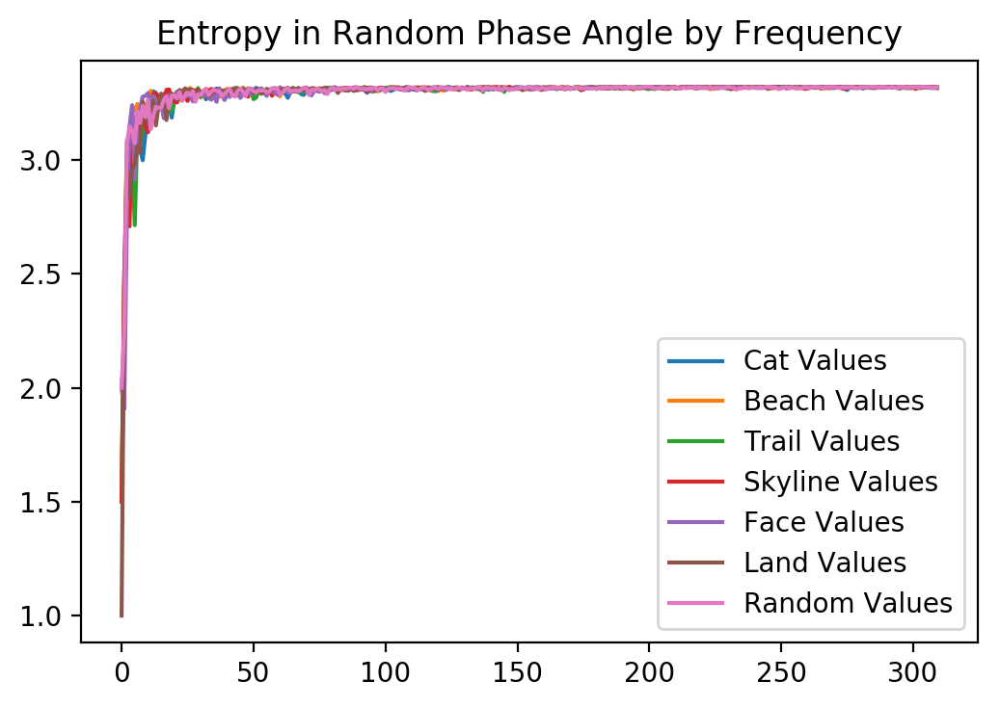

In [26]:
rads, cat_vals = radial_Analysis(angle_cats, calc_entropy)
rads, beach_vals = radial_Analysis(angle_beach, calc_entropy)
rads, skyline_vals = radial_Analysis(angle_skyline, calc_entropy)
rads, trail_vals = radial_Analysis(angle_trail, calc_entropy)
rads, face_vals = radial_Analysis(angle_face, calc_entropy)
rads, land_vals = radial_Analysis(angle_land, calc_entropy)
rads, rand_vals = radial_Analysis(random_phase, calc_entropy)


plt.figure()
plt.plot(rads, cat_vals, label='Cat Values')
plt.plot(rads, beach_vals, label='Beach Values')
plt.plot(rads, trail_vals, label='Trail Values')
plt.plot(rads, skyline_vals, label='Skyline Values')
plt.plot(rads, face_vals, label='Face Values')
plt.plot(rads, land_vals, label='Land Values')

plt.plot(rads, rand_vals, label='Random Values')
plt.legend()
# plt.gca().set_yscale("log", nonposy='clip')
plt.title('Entropy in Random Phase Angle by Frequency')

This would be a negative result. Random looks the same as images. I'm guessing because the structure does not seem to be among different directions at the same frequency, but within the same angle at all frequencies.

## Phase Entropy Among Frequencies Within Angle

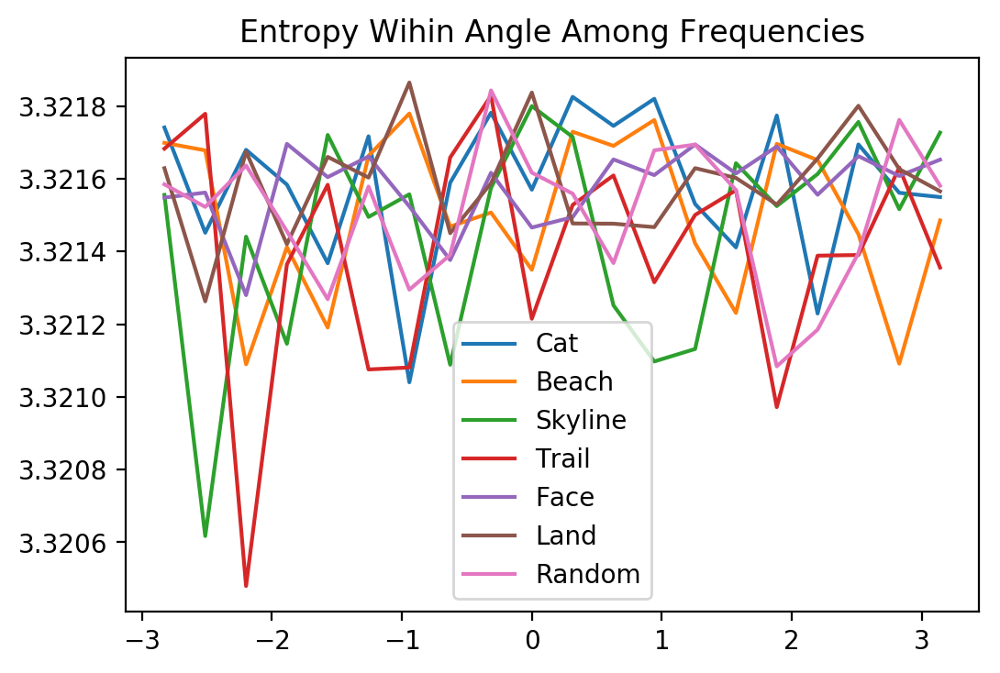

In [27]:
def direction_Analysis(signal2d, func, nbins=20, sample=True, center=None):
    """
    Calculate a signal along radial profile.

    signal2d - 2d signal to be analyzed (not necessarily an signal_2ds)
    func - function to be applied to signal radially
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the signal (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the signal_2ds
    y, x = np.indices(signal2d.shape)

    center = np.array([(x.max()-x.min())/2.0, (y.max()-y.min())/2.0])
    
    a = np.arctan2(( y - center[1]),(x - center[0]))
    #return(r) # can run imshow(r) to test correct

    ind = np.argsort(a.flat)
    a_sorted = a.flat[ind]
    i_sorted = signal2d.flat[ind]

    #digitize cleanly
    linbins = np.linspace(-np.pi,np.pi,nbins+1)
    a_digitized = np.take(linbins,np.digitize(a_sorted,linbins,right=True))

    #digitize by int
    # Get the integer part of the angle (bin size = 1)
    #a_digitized = a_sorted.astype(int)

    #if we are using a quantity that depends on population size, figure out the smallest population size in an angle
    #sample to reduce all angles to this number of samples.
    if(sample):
        from collections import Counter
        least_common = Counter(a_digitized).most_common()[-1]
        subset_size = least_common[1] #get number of values for least common

    angs = np.unique(a_digitized)
    vals= []
    for ang in angs:
        pxls = i_sorted[np.where(a_digitized == ang)]
        if(sample):
            pxls = np.random.choice(pxls, size=subset_size, replace=False) #take the smallest subset
        vals.append(func(pxls))

    return(angs, vals)


catangles, catentropy = direction_Analysis(angle_cats, calc_entropy)
beachangles, beachentropy = direction_Analysis(angle_beach, calc_entropy)
trailangles, trailentropy = direction_Analysis(angle_trail, calc_entropy)
skylineangles, skylineentropy = direction_Analysis(angle_skyline, calc_entropy)
faceangles, faceentropy = direction_Analysis(angle_face, calc_entropy)
landangles, landentropy = direction_Analysis(angle_land, calc_entropy)
randangles, randentropy = direction_Analysis(random_phase, calc_entropy)

#if we don't sample we get artifacts
# rannosampleangles, ranentropynosample = direction_Analysis(random_phase, calc_entropy, sample= False)
# catnosampleangles, catentropynosample = direction_Analysis(angle_cats, calc_entropy, sample= False)
# plt.plot(catnosampleangles, catentropynosample, label='catnosample')
# plt.plot(rannosampleangles, ranentropynosample,label='Randomnosamlpe')


plt.plot(catangles, catentropy,label='Cat')
plt.plot(beachangles, beachentropy,label='Beach')
plt.plot(skylineangles, skylineentropy,label='Skyline')
plt.plot(trailangles, trailentropy,label='Trail')
plt.plot(faceangles, faceentropy, label='Face')
plt.plot(landangles, landentropy, label='Land')
plt.plot(randangles, randentropy,label='Random')

plt.title('Entropy Wihin Angle Among Frequencies')
plt.legend()

Our phase data doesn't look any different from random. 

## Scramble Amplitude and Phase

(-0.5, 825.5, 619.5, -0.5)

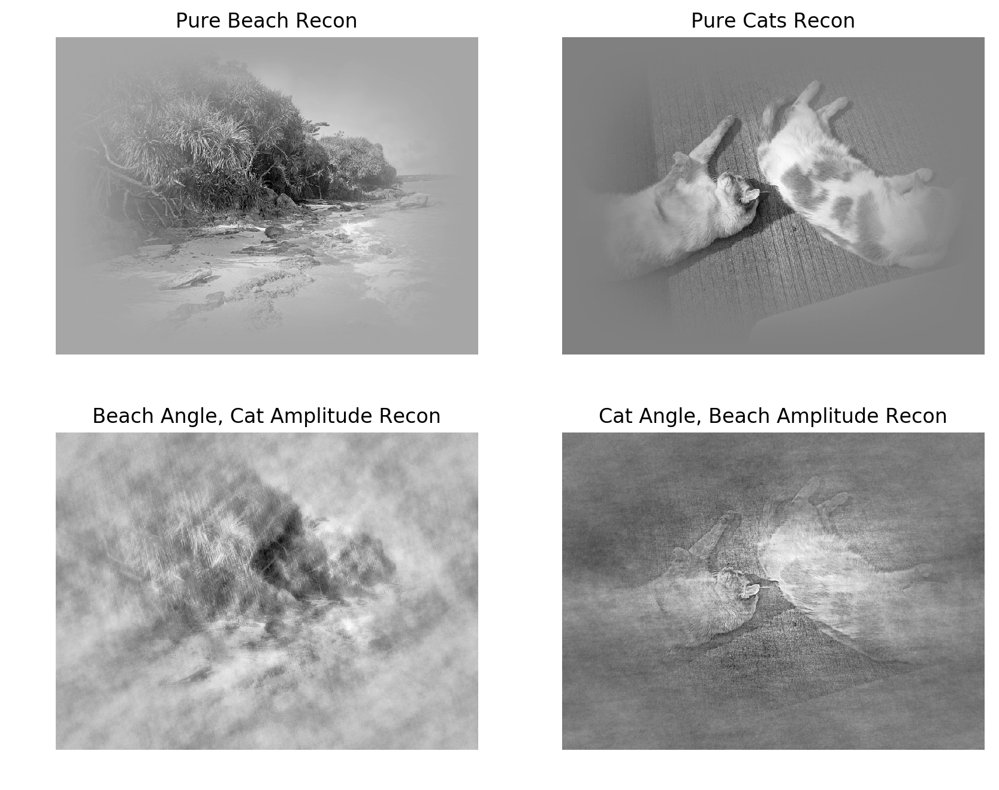

In [28]:
recon_beach = np.fft.ifft2(np.fft.ifftshift(amp_beach* np.exp(1j*angle_beach)))
recon_cats = np.fft.ifft2(np.fft.ifftshift(amp_cats* np.exp(1j*angle_cats)))
recon_anglebeach_ampcats = np.fft.ifft2(np.fft.ifftshift(amp_cats* np.exp(1j*angle_beach)))
recon_anglcats_ampbeach = np.fft.ifft2(np.fft.ifftshift(amp_beach* np.exp(1j*angle_cats)))

plt.figure(figsize=(10,8))

plt.subplot(2,2,1)
plt.imshow(np.real(recon_beach),cmap='Greys_r')
plt.title('Pure Beach Recon')
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(np.real(recon_cats),cmap='Greys_r')
plt.title('Pure Cats Recon')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(np.real(recon_anglebeach_ampcats),cmap='Greys_r')
plt.title('Beach Angle, Cat Amplitude Recon')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(np.real(recon_anglcats_ampbeach),cmap='Greys_r')
plt.title('Cat Angle, Beach Amplitude Recon')
plt.axis('off')


Looks like the classic result, with the phase component 'taking over', and defining the shape of the image much more

## Combine Phase with 1/f Amplitude

Text(0.5,1,'Cats Angle, 1/f Amp Recon')

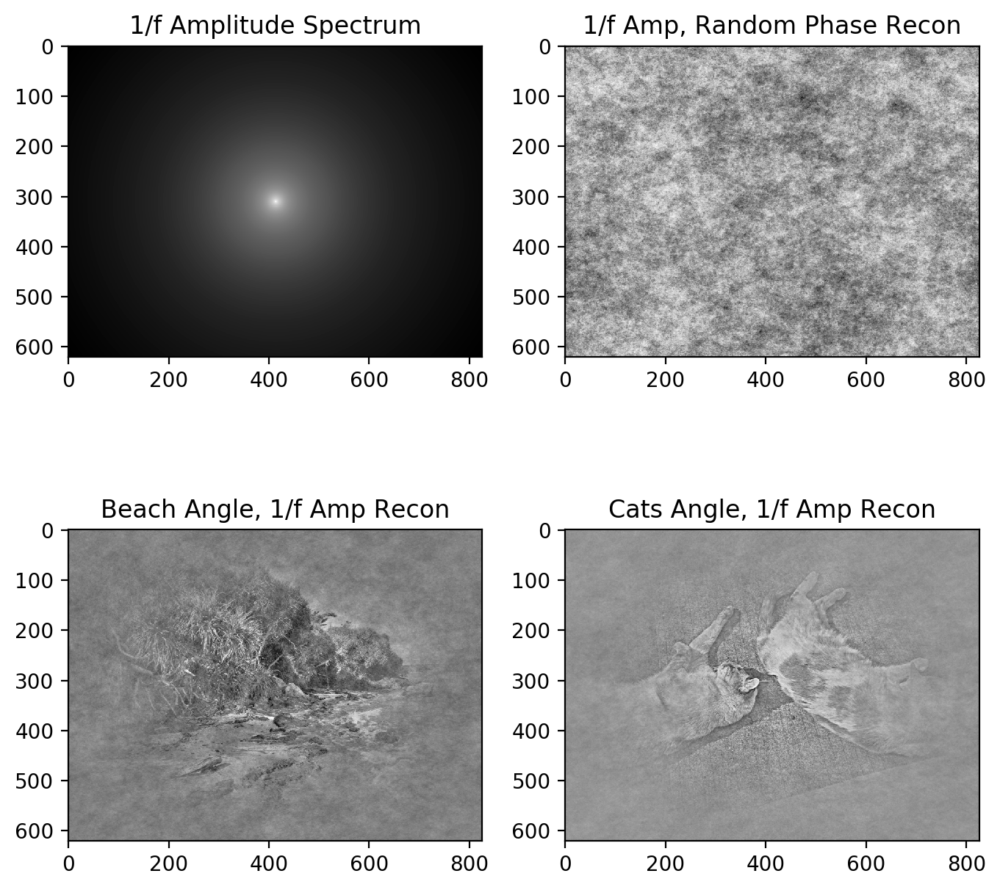

In [29]:
f_alpha = 1.0
f_k = 1

# def oneOverF(freq,alpha,k):
#     freq = np.abs(freq)
#     amp = k/(1+freq**alpha)
#     return amp

def make_onef(shape, alpha, k):
    y, x = np.indices(shape)
    center = np.array(shape)/2
    r = np.hypot(x - center[1], y - center[0])
    amp = k/(1+r**alpha)
    return amp
    
amp_onef = make_onef(np.shape(cats),f_alpha, f_k)

# onef_rows = np.expand_dims(oneOverF(freqs_rows, f_alpha, f_k),axis=1)
# onef_cols = np.expand_dims(oneOverF(freqs_cols, f_alpha, f_k),axis=0)
# amp_onef = (onef_rows @ onef_cols) # * ft_noise
random_phase = np.random.rand(*ft_cats.shape)*2*np.pi - np.pi

recon_onef_rand = np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*random_phase)))

recon_onef_beach = np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*angle_beach)))
recon_onef_cats = np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*angle_cats)))

plt.figure(figsize=(8,8))

plt.subplot(2,2,1)
plt.imshow(np.log(amp_onef), cmap='Greys_r')
plt.title('1/f Amplitude Spectrum')

plt.subplot(2,2,2)
plt.imshow(np.real(recon_onef_rand),cmap='Greys_r')
plt.title('1/f Amp, Random Phase Recon')

plt.subplot(2,2,3)
plt.imshow(np.real(recon_onef_beach), cmap='Greys_r')
plt.title('Beach Angle, 1/f Amp Recon')

plt.subplot(2,2,4)
plt.imshow(np.real(recon_onef_cats), cmap='Greys_r')
plt.title('Cats Angle, 1/f Amp Recon')


Text(0.5,1,'1/f Noise')

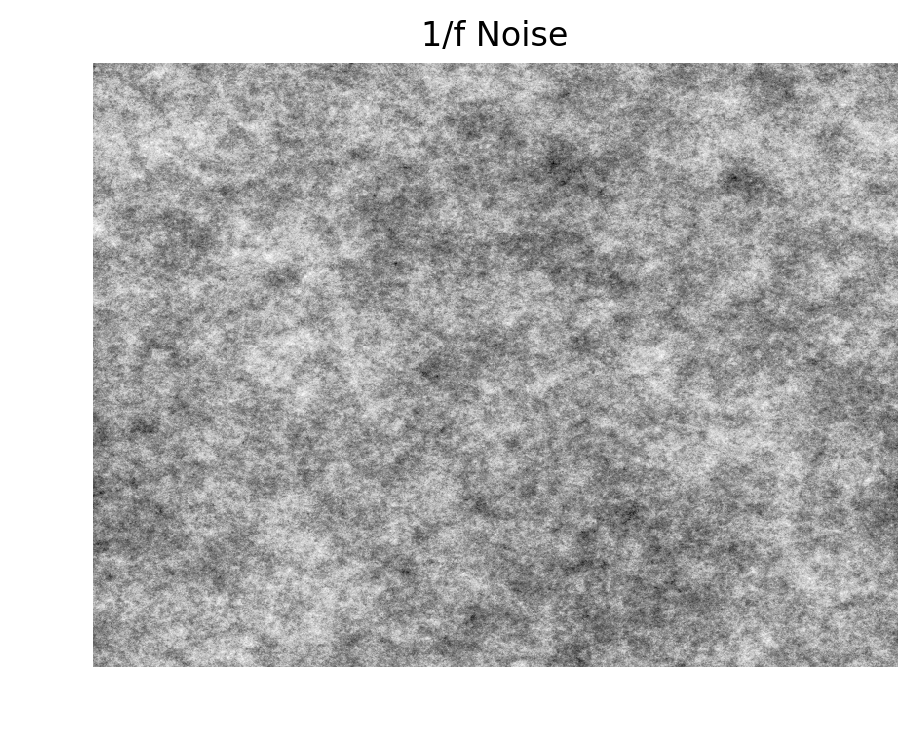

In [30]:
plt.imshow(np.real(recon_onef_rand), cmap='Greys_r')
plt.axis('off')
plt.title('1/f Noise')

Text(0.5,1,'Beach amplitude spectrum (log)')

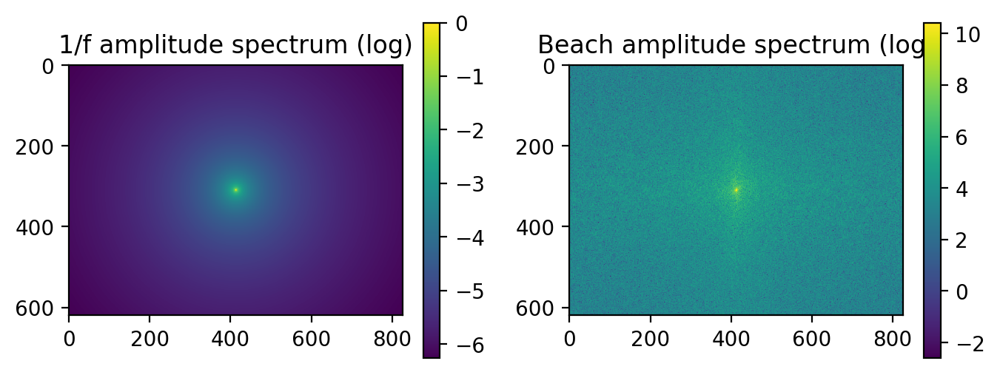

In [31]:
plt.figure(figsize=(8,3))

plt.subplot(1,2,1)
plt.imshow(np.log(amp_onef))
plt.colorbar()
plt.title('1/f amplitude spectrum (log)')

plt.subplot(1,2,2)
plt.imshow(np.log(amp_beach))
plt.colorbar()
plt.title('Beach amplitude spectrum (log)')

## Try Random Amplitude

Text(0.5,1,'Random Amp, Cat Phase Recon')

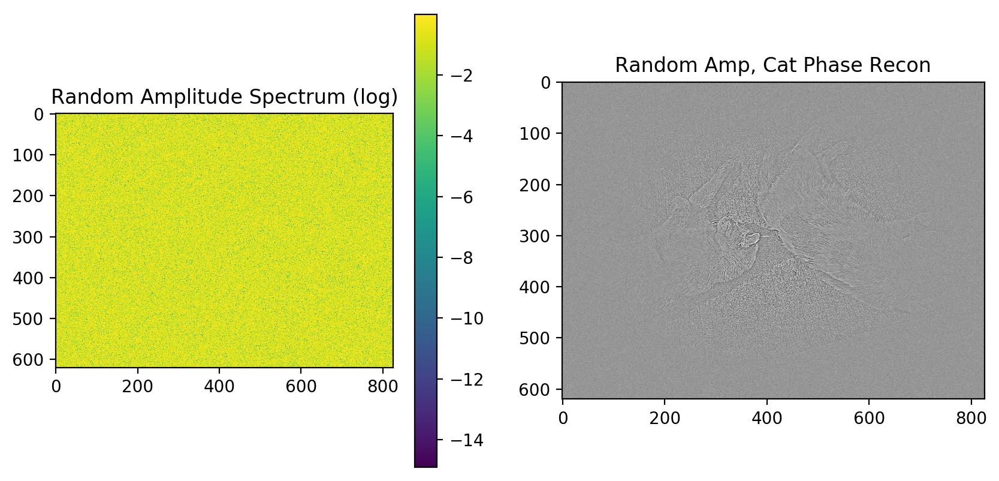

In [32]:
rand_noise = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])
recon_rand_cats = np.fft.ifft2(np.fft.ifftshift(rand_noise*np.exp(1j*angle_cats)))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(np.log(rand_noise))
plt.title('Random Amplitude Spectrum (log)')
plt.colorbar()


plt.subplot(1,2,2)        
plt.imshow(np.real(recon_rand_cats),cmap='Greys_r');
plt.title('Random Amp, Cat Phase Recon')
#plt.colorbar()

## Try Constant Amplitude

Text(0.5,1,'Constant Amp, Cat Phase Recon')

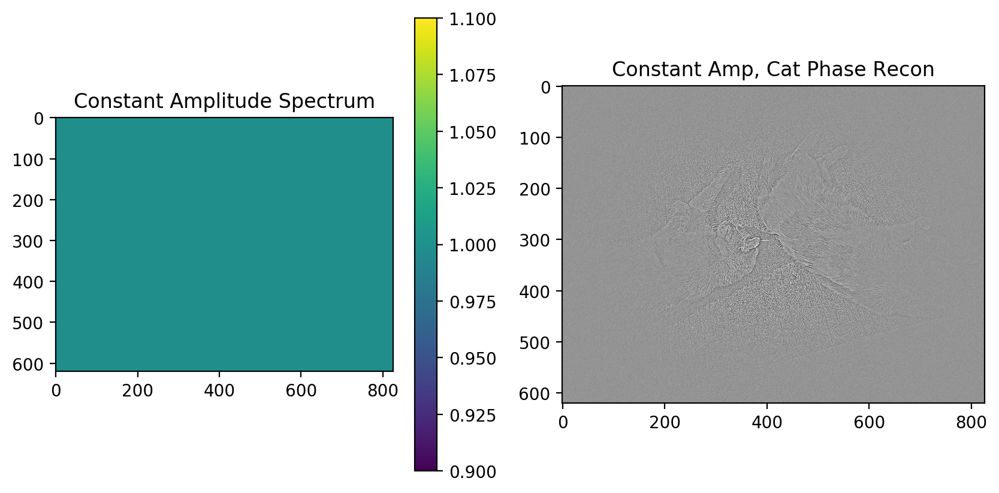

In [33]:
const_amp = np.ones((np.shape(angle_cats)[0],np.shape(angle_cats)[1]))
recon_const_cats = np.fft.ifft2(np.fft.ifftshift(const_amp*np.exp(1j*angle_cats)))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(const_amp)
plt.title('Constant Amplitude Spectrum')
plt.colorbar()


plt.subplot(1,2,2)        
plt.imshow(np.real(recon_const_cats),cmap='Greys_r');
plt.title('Constant Amp, Cat Phase Recon')
#plt.colorbar()

Text(0.5,1,'Cats Amplitude')

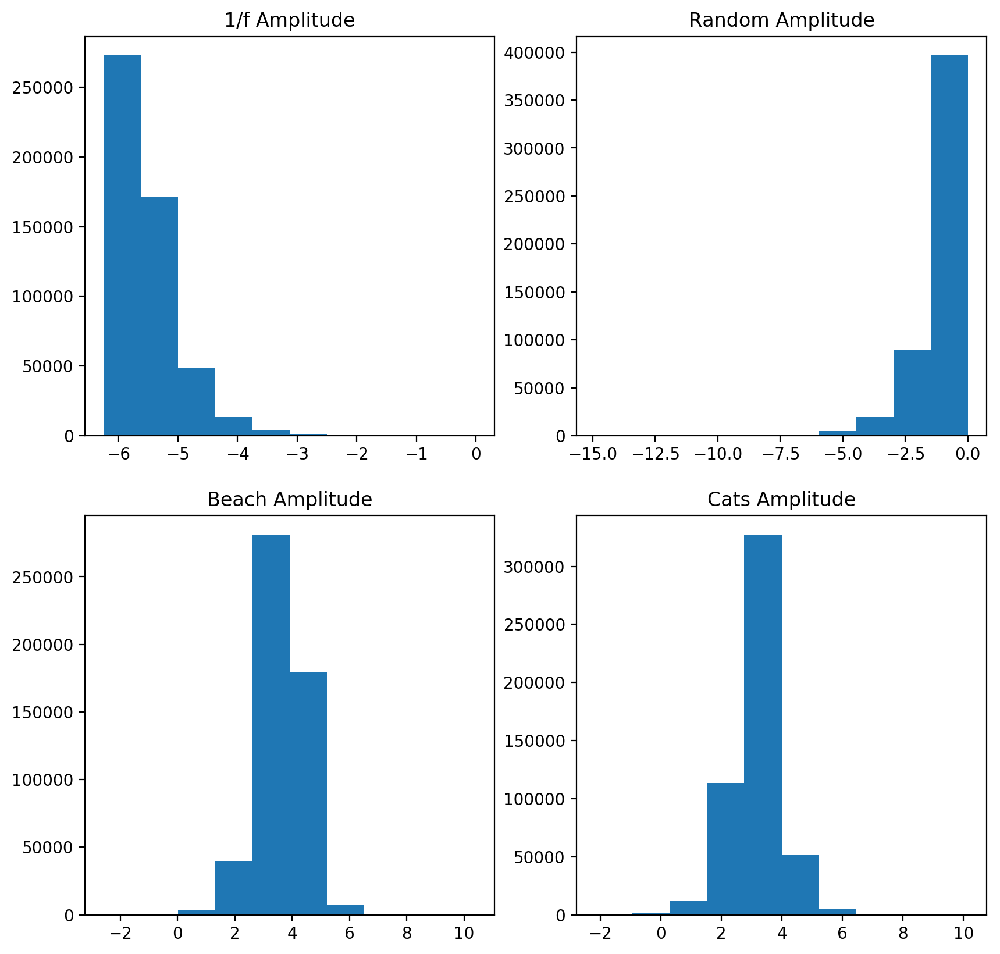

In [34]:
plt.figure(figsize=(10,10))

plt.subplot(2,2,1)
plt.hist(np.log(amp_onef.flatten()));
plt.title('1/f Amplitude')
plt.subplot(2,2,2)
plt.hist(np.log(rand_noise.flatten()));
plt.title('Random Amplitude')
plt.subplot(2,2,3)
plt.hist(np.log(amp_beach.flatten()));
plt.title('Beach Amplitude')
plt.subplot(2,2,4)
plt.hist(np.log(amp_cats.flatten()));
plt.title('Cats Amplitude')

I think there is something wrong with the normalization here, which I'm guessing is why these reconstructions are barely recognizable. Maybe need to normalize them (see van der Schaff & Hateren 1995, Field 1987). Maybe if we can normalize these correctly, the reconstrution would be better.

## Try Random Phase
Do this twice. How much does the random seed affect what we see?

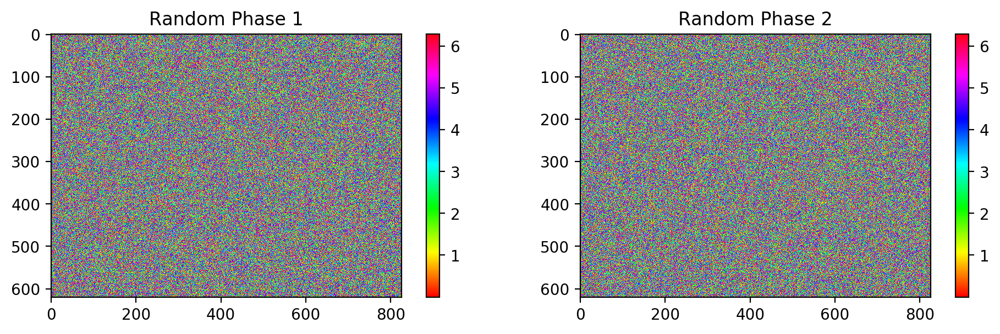

In [35]:
rand_noise_1 = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])*2*np.pi
recon_rand_phase_cats_1 = np.fft.ifft2(np.fft.ifftshift(amp_cats*np.exp(1j*rand_noise_1)))
recon_rand_phase_beach_1 = np.fft.ifft2(np.fft.ifftshift(amp_beach*np.exp(1j*rand_noise_1)))

rand_noise_2 = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])*2*np.pi
recon_rand_phase_cats_2 = np.fft.ifft2(np.fft.ifftshift(amp_cats*np.exp(1j*rand_noise_2)))
recon_rand_phase_beach_2 = np.fft.ifft2(np.fft.ifftshift(amp_beach*np.exp(1j*rand_noise_2)))

plt.figure(figsize=(10,3))

plt.subplot(1,2,1)
plt.imshow(rand_noise_1, cmap='hsv')
plt.title('Random Phase 1')
plt.colorbar()

plt.subplot(1,2,2)
plt.imshow(rand_noise_2, cmap='hsv')
plt.title('Random Phase 2')
plt.colorbar()

plt.tight_layout()

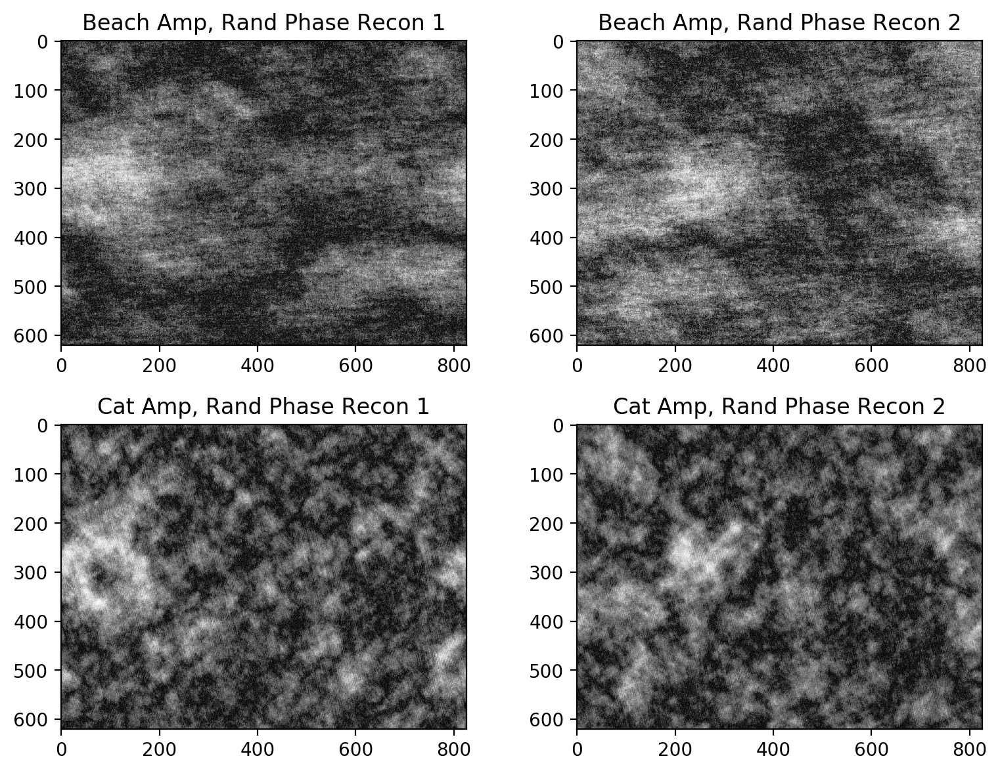

In [36]:
plt.figure(figsize=(8,6))

plt.subplot(2,2,1)
plt.imshow(np.abs(recon_rand_phase_beach_1),cmap='Greys_r');
plt.title('Beach Amp, Rand Phase Recon 1')
#plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(np.abs(recon_rand_phase_beach_2),cmap='Greys_r');
plt.title('Beach Amp, Rand Phase Recon 2')
#plt.colorbar()

plt.subplot(2,2,3)        
plt.imshow(np.abs(recon_rand_phase_cats_1),cmap='Greys_r');
plt.title('Cat Amp, Rand Phase Recon 1')
#plt.colorbar()


plt.subplot(2,2,4)        
plt.imshow(np.abs(recon_rand_phase_cats_2),cmap='Greys_r');
plt.title('Cat Amp, Rand Phase Recon 2')
#plt.colorbar()

plt.tight_layout()

Interesting. Phase seems to have the 'structure', while amplitude holds the 'texture'

## Throw away phases for high frequency components

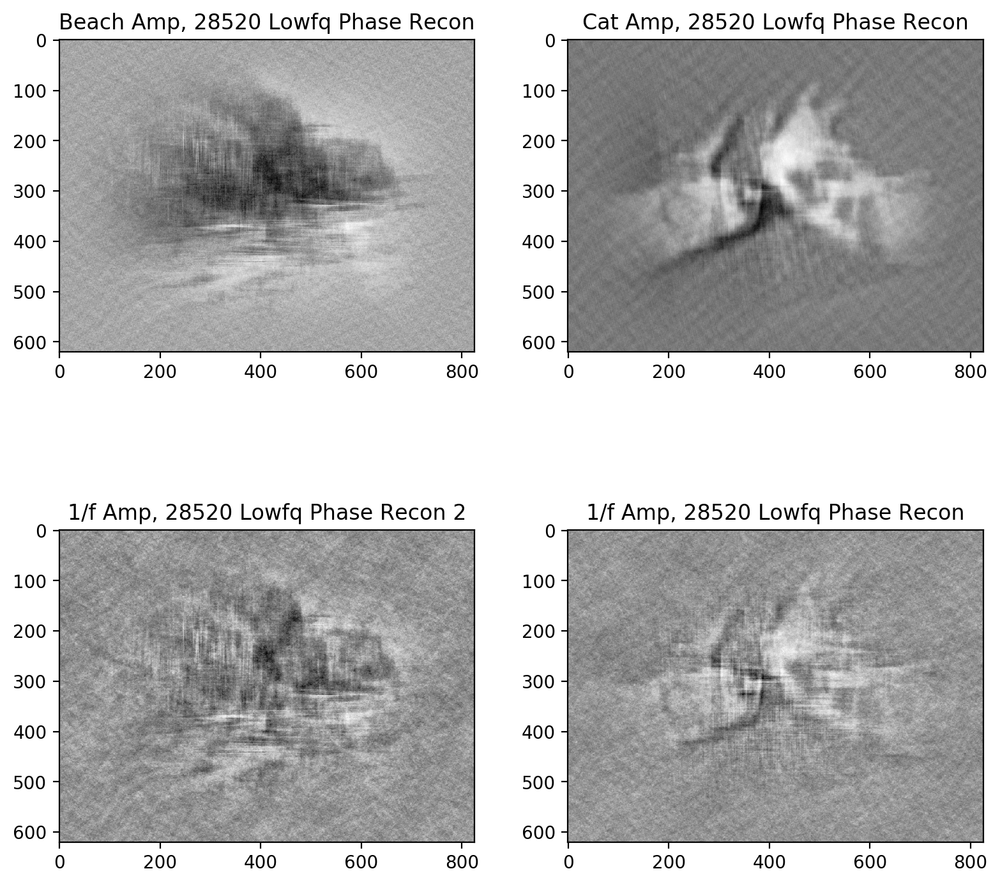

In [37]:
nlowphases = 20
numbers = nlowphases*dimx + nlowphases*dimy - nlowphases**2
neachside = int(nlowphases/2)

cats_lowfq_phase = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])*2*np.pi
cats_lowfq_phase[xhalf-neachside:xhalf+neachside,:] = angle_cats[xhalf-neachside:xhalf+neachside,:]
cats_lowfq_phase[:,yhalf-neachside:yhalf+neachside] = angle_cats[:,yhalf-neachside:yhalf+neachside]

beach_lowfq_phase = np.random.rand(np.shape(angle_beach)[0],np.shape(angle_beach)[1])*2*np.pi
beach_lowfq_phase[xhalf-neachside:xhalf+neachside,:] = angle_beach[xhalf-neachside:xhalf+neachside,:]
beach_lowfq_phase[:,yhalf-neachside:yhalf+neachside] = angle_beach[:,yhalf-neachside:yhalf+neachside]

recon_lowfq_phase_cats = np.fft.ifft2(np.fft.ifftshift(amp_cats*np.exp(1j*cats_lowfq_phase)))
recon_lowfq_phase_beach = np.fft.ifft2(np.fft.ifftshift(amp_beach*np.exp(1j*beach_lowfq_phase)))

recon_lowfq_phase_randamp_cats = np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*cats_lowfq_phase)))
recon_lowfq_phase_randamp_beach = np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*beach_lowfq_phase)))


plt.figure(figsize=(8,8))

plt.subplot(2,2,1)
plt.title('Beach Amp, {} Lowfq Phase Recon'.format(numbers))
plt.imshow(np.real(recon_lowfq_phase_beach),cmap='Greys_r');
#plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(np.real(recon_lowfq_phase_cats),cmap='Greys_r');
plt.title('Cat Amp, {} Lowfq Phase Recon'.format(numbers))
#plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(np.real(recon_lowfq_phase_randamp_beach),cmap='Greys_r');
plt.title('1/f Amp, {} Lowfq Phase Recon 2'.format(numbers))        

#plt.colorbar()

plt.subplot(2,2,4)       
plt.imshow(np.real(recon_lowfq_phase_randamp_cats),cmap='Greys_r');
plt.title('1/f Amp, {} Lowfq Phase Recon'.format(numbers))
#plt.colorbar()

plt.tight_layout()

This is cool that we can see structure in the images even though we are throwing out so much info. but wavelets still do better, so we haven't revolutionalized image compression. What it does tell us though that is very interesting, is that these 20 rows and 20 columns out of 800/600 have a lot of info about the image's structure in them. Are there statistical regularities in these rows/columns that are invariant in natural images?

# Playing with 2D FFT Phase

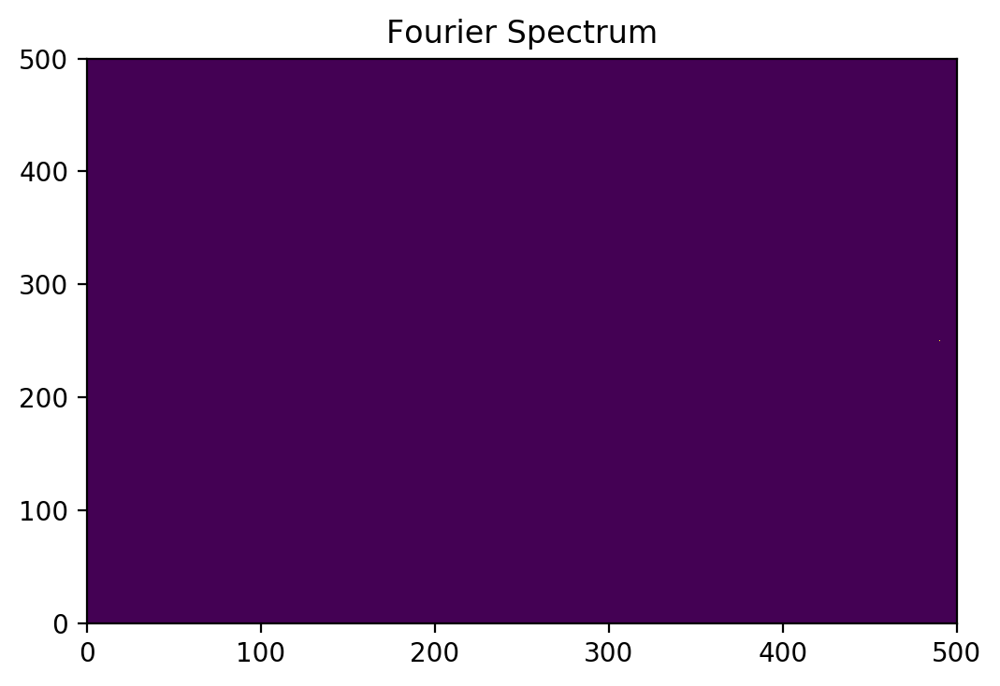

Text(0.5,1,'Image')

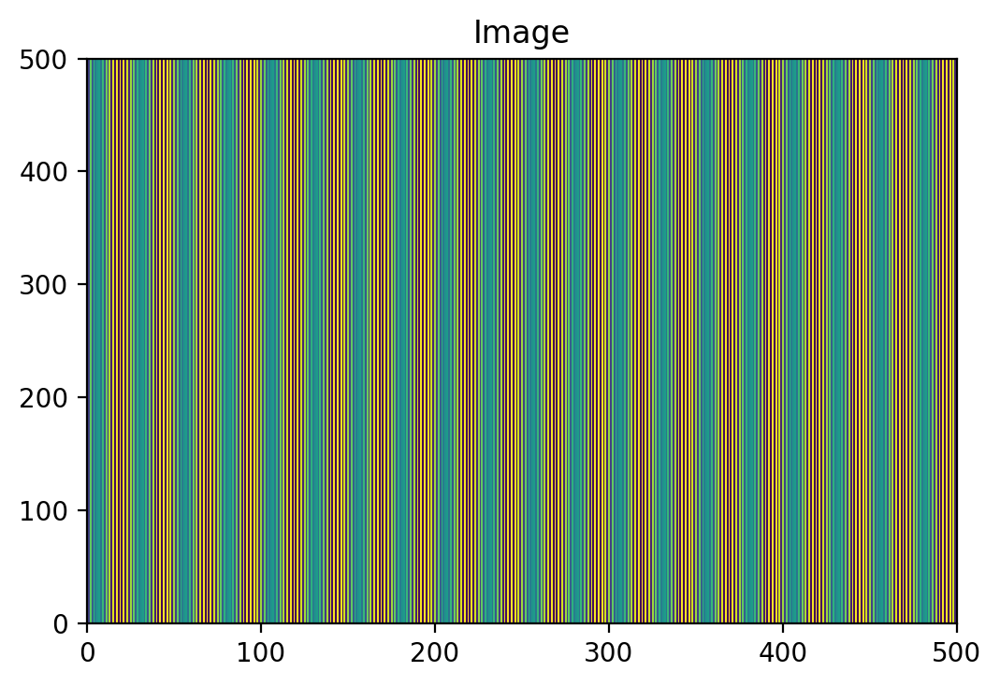

In [38]:
blank_array = np.zeros([500, 500], dtype=complex)

blank_array[250,490] = np.exp(-1j*np.pi/4)

plt.pcolormesh(np.real(blank_array))
plt.title("Fourier Spectrum")

plt.show()
fft_blank = np.fft.ifftshift(np.fft.ifftshift(blank_array, axes=0), axes=1)
fft_blank = np.fft.ifft2(fft_blank)
plt.pcolormesh(np.real(fft_blank))
plt.title("Image")




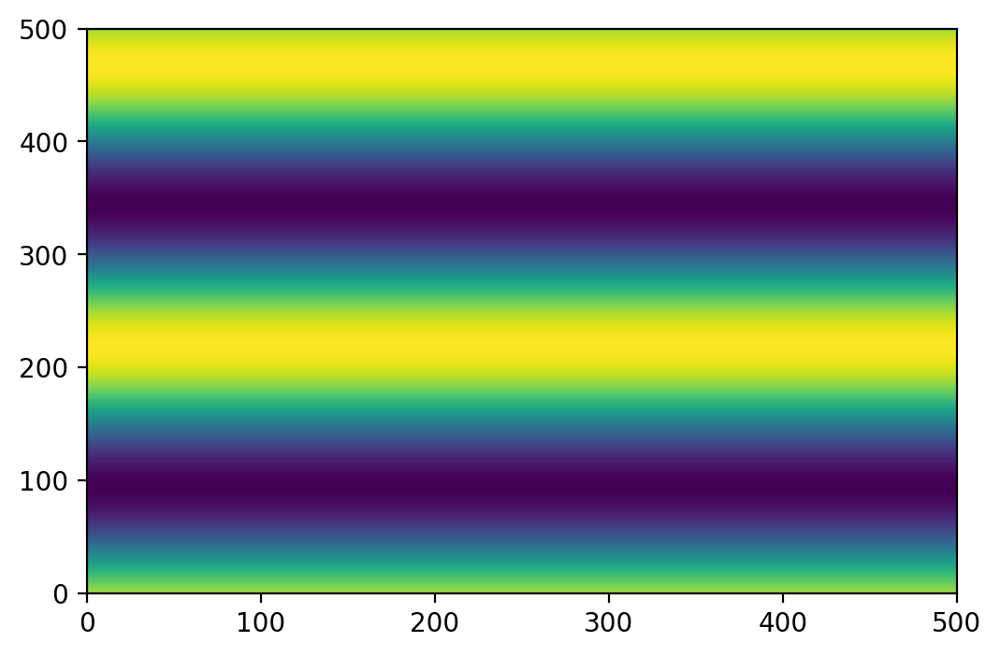

In [39]:
blank_array = np.zeros([500, 500], dtype=complex)

blank_array[252, 250] = np.exp(1j*np.pi/4.)

fft_blank = np.fft.ifftshift(np.fft.ifftshift(blank_array, axes=0), axes=1)
fft_blank = np.fft.ifft2(fft_blank)


plt.pcolormesh(np.real(fft_blank))

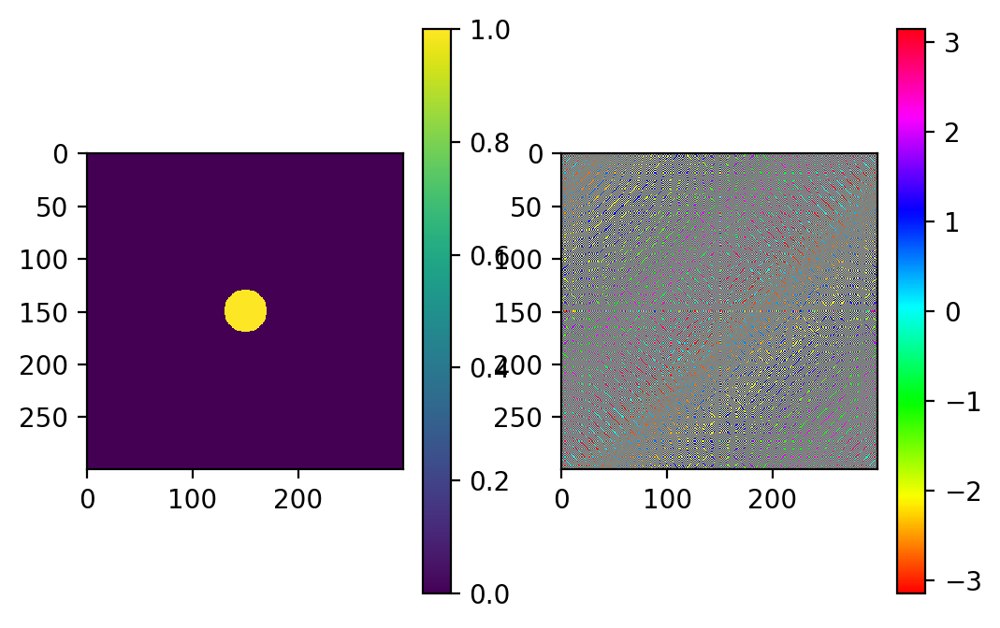

In [40]:
shape = np.zeros((300,300))
y, x = np.indices(shape.shape)
center = np.array([(x.max()-x.min())/2.0, (y.max()-y.min())/2.0])
r = np.hypot(x - center[0], y - center[1])
r = 1/r
coff = 0.05
r[r<coff] = 0
r[r>=coff] = 1

rft = np.fft.fft2(r)
rang = np.angle(rft)

plt.subplot(1,2,1)
plt.imshow(r)
plt.colorbar()

plt.subplot(1,2,2)
plt.imshow(rang, cmap='hsv')
plt.colorbar()


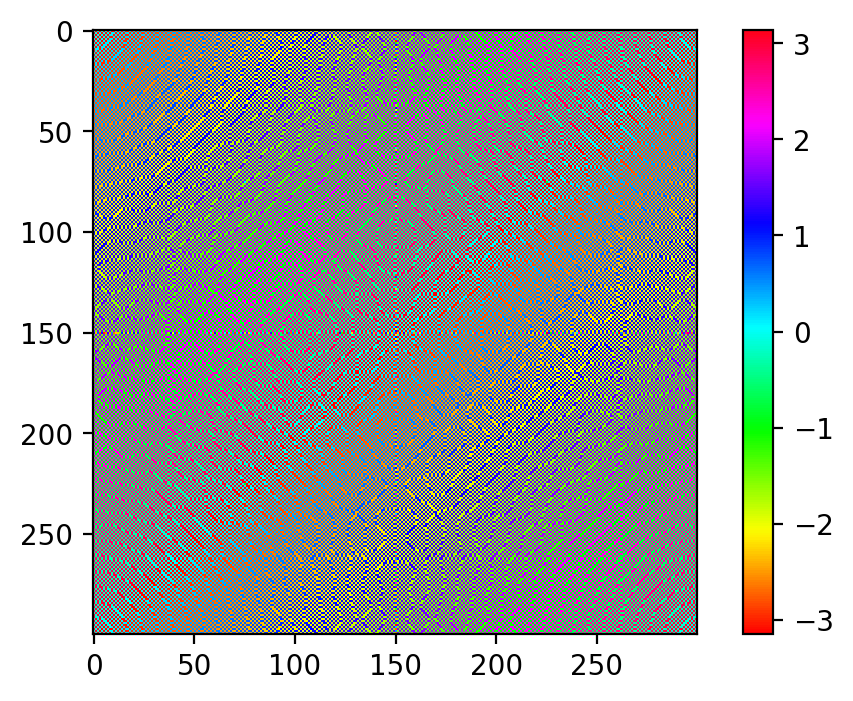

In [41]:
plt.imshow(rang,cmap='hsv')
plt.colorbar()
